## Multiple Species Frames Analysis

In [1]:
from pathlib import Path
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import json

In [2]:
pd.set_option('display.max_columns', 1000)

In [3]:
# Defining directories
dir_path = Path.cwd().parent
data_folder = dir_path.joinpath("data/processed")
df_path = data_folder.joinpath("model_df.parquet")
df_2024_path = data_folder.joinpath("model_df_2024.parquet")

species_dict_path = dir_path.joinpath("data/species_dict.json")

out_folder = dir_path.joinpath("docs/boxplots/normalized_values")

In [4]:
west_low_species = [11, 8, 7, 6, 5, 4, 3, 1] #target
mid_line_species = [13, 12, 10, 9, 2, 0] #control

In [5]:
with open(species_dict_path, "r") as infile:
    species_dict = json.load(infile)

species_dict

{'0': 'Aesculus indica',
 '1': 'Bambusoideae spp.',
 '2': 'Cedrus deodara',
 '3': 'Dendrocalamus strictus',
 '4': 'Eucalyptus globulus',
 '5': 'Lantana camara',
 '6': 'Mangifera sylvatica',
 '7': 'Phyllanthus emblica',
 '8': 'Pinus roxburghii',
 '9': 'Quercus leucotrichophora',
 '10': 'Rhododendron arboreum',
 '11': 'Senegalia catechu',
 '12': 'Shorea robusta',
 '13': 'Taxus baccata'}

In [6]:
df = pd.read_parquet(df_path)
df

,long,lat,year,species,vv_Descendingsummer,vv_Descendingwinter,vh_Descendingsummer,vh_Descendingwinter,vv_Ascendingsummer,vv_Ascendingwinter,vh_Ascendingsummer,vh_Ascendingwinter,VV_VH_Asummer,VV_VH_Awinter,VV_VH_Dsummer,VV_VH_Dwinter,VH_VV_Asummer,VH_VV_Awinter,VH_VV_Dsummer,VH_VV_Dwinter,SAR_NDVI_Asummer,SAR_NDVI_Awinter,SAR_NDVI_Dsummer,SAR_NDVI_Dwinter,DVI_Asummer,DVI_Awinter,DVI_Dsummer,DVI_Dwinter,SVI_Asummer,SVI_Awinter,SVI_Dsummer,SVI_Dwinter,RDVI_Asummer,RDVI_Awinter,RDVI_Dsummer,RDVI_Dwinter,NRDVI_Asummer,NRDVI_Awinter,NRDVI_Dsummer,NRDVI_Dwinter,SSDVI_Asummer,SSDVI_Awinter,SSDVI_Dsummer,SSDVI_Dwinter,B11summer,B11winter,B02summer,B02winter,B12summer,B12winter,B08summer,B08winter,B04summer,B04winter,B03summer,B03winter,NDVIsummer,NDVIwinter,ARVI2summer,ARVI2winter,BWDRVIsummer,BWDRVIwinter,CVIsummer,CVIwinter,CTVIsummer,CTVIwinter,EVI2summer,EVI2winter,GVMIsummer,GVMIwinter,MSVAIhypersummer,MSVAIhyperwinter,MTVI2summer,MTVI2winter,MNDVIsummer,MNDVIwinter,OSAVIsummer,OSAVIwinter,PVIsummer,PVIwinter,SARVIsummer,SARVIwinter,SLAVIsummer,SLAVIwinter,TSAVI2summer,TSAVI2winter,WDVIsummer,WDVIwinter,WDRVIsummer,WDRVIwinter,sand_f,elevation,cfvo_f,phh2o_f,soc_f,slope,clay_f,nitrogen_f,cec_f,bdod_f,aspect,silt_f,ocd_f
0,75.66669580000007,32.25107380000003,2018,1,0.396606,0.471055,0.416042,0.470285,0.451115,0.404824,0.341066,0.350320,0.338847,0.269886,0.336448,0.307829,0.519535,0.602601,0.497106,0.506712,0.584585,0.662452,0.574248,0.594059,0.621240,0.716986,0.636023,0.628458,0.392045,0.417418,0.344660,0.484055,0.605552,0.680172,0.596939,0.617232,0.564211,0.645100,0.552461,0.572055,0.664566,0.754933,0.690628,0.665937,0.313081,0.228517,0.162219,0.118167,0.317432,0.262492,0.310292,0.278019,0.190256,0.129642,0.190458,0.140687,0.669431,0.551376,0.669431,0.551376,0.487001,0.646174,0.005272,0.280977,0.815603,0.662993,0.382663,0.421141,0.431660,0.561714,0.408945,0.475636,0.363129,0.447514,0.412795,0.542756,0.493089,0.560768,0.310292,0.278019,1.0,1.0,0.114210,0.146335,0.461660,0.460997,0.303479,0.271846,0.433215,0.551315,0.19650,0.024909,0.319782,0.469907,0.040873,0.197817,0.585997,0.088080,0.101551,0.636993,0.708511,0.576992,0.118323
1,75.66669580000007,32.25107380000003,2019,1,0.460550,0.446541,0.429824,0.487266,0.366455,0.478185,0.370159,0.362405,0.183898,0.322430,0.383513,0.300665,0.709946,0.540842,0.444008,0.515246,0.761503,0.603882,0.522477,0.602234,0.788002,0.664917,0.574423,0.633923,0.355852,0.417348,0.407194,0.471022,0.774423,0.624019,0.547459,0.624950,0.748836,0.584238,0.498555,0.580663,0.808862,0.710048,0.625380,0.669283,0.274354,0.238709,0.117719,0.122591,0.257691,0.263396,0.272727,0.308818,0.142307,0.134439,0.137201,0.143900,0.694305,0.559657,0.694305,0.559657,0.580706,0.665711,0.008468,0.302683,0.831119,0.669948,0.433430,0.450585,0.473029,0.584626,0.457725,0.509849,0.404839,0.477641,0.441885,0.570223,0.577584,0.584228,0.272727,0.308818,1.0,1.0,0.150823,0.158899,0.461616,0.461170,0.312718,0.302638,0.533531,0.565906,0.19650,0.024909,0.319782,0.469907,0.040873,0.197817,0.585997,0.088080,0.101551,0.636993,0.708511,0.576992,0.118323
2,75.66669580000007,32.25107380000003,2020,1,0.431712,0.452766,0.498169,0.413335,0.378641,0.409808,0.347632,0.350206,0.238847,0.333536,0.381426,0.385602,0.638601,0.528305,0.446605,0.421169,0.696887,0.591767,0.524909,0.509017,0.731041,0.645299,0.569751,0.561549,0.350470,0.365744,0.410065,0.458816,0.713037,0.612352,0.549750,0.536319,0.681090,0.571704,0.501122,0.483209,0.762694,0.695944,0.626819,0.614591,0.296447,0.233513,0.151789,0.112627,0.289345,0.264374,0.335080,0.286403,0.173430,0.134302,0.177465,0.139276,0.654840,0.579912,0.654840,0.579912,0.514843,0.666735,0.005749,0.296927,0.806094,0.687194,0.451147,0.416834,0.484453,0.555216,0.479883,0.471391,0.434758,0.435182,0.469696,0.537254,0.569279,0.550948,0.335080,0.286403,1.0,1.0,0.149061,0.141805,0.461722,0.461076,0.357819,0.275241,0.498464,0.538463,0.19650,0.024909,0.319782,0.469907,0.040873,0.197817,0.585997,0.088080,0.101551,0.636993,0.708511,0.576

In [7]:
df_2024 = pd.read_parquet(df_2024_path)
df_2024.insert(2,'year', 2024)
df_2024

,long,lat,year,species,vv_Descendingsummer,vv_Descendingwinter,vh_Descendingsummer,vh_Descendingwinter,vv_Ascendingsummer,vv_Ascendingwinter,vh_Ascendingsummer,vh_Ascendingwinter,VV_VH_Asummer,VV_VH_Awinter,VV_VH_Dsummer,VV_VH_Dwinter,VH_VV_Asummer,VH_VV_Awinter,VH_VV_Dsummer,VH_VV_Dwinter,SAR_NDVI_Asummer,SAR_NDVI_Awinter,SAR_NDVI_Dsummer,SAR_NDVI_Dwinter,DVI_Asummer,DVI_Awinter,DVI_Dsummer,DVI_Dwinter,SVI_Asummer,SVI_Awinter,SVI_Dsummer,SVI_Dwinter,RDVI_Asummer,RDVI_Awinter,RDVI_Dsummer,RDVI_Dwinter,NRDVI_Asummer,NRDVI_Awinter,NRDVI_Dsummer,NRDVI_Dwinter,SSDVI_Asummer,SSDVI_Awinter,SSDVI_Dsummer,SSDVI_Dwinter,B11summer,B11winter,B02summer,B02winter,B12summer,B12winter,B08summer,B08winter,B04summer,B04winter,B03summer,B03winter,NDVIsummer,NDVIwinter,ARVI2summer,ARVI2winter,BWDRVIsummer,BWDRVIwinter,CVIsummer,CVIwinter,CTVIsummer,CTVIwinter,EVI2summer,EVI2winter,GVMIsummer,GVMIwinter,MSVAIhypersummer,MSVAIhyperwinter,MTVI2summer,MTVI2winter,MNDVIsummer,MNDVIwinter,OSAVIsummer,OSAVIwinter,PVIsummer,PVIwinter,SARVIsummer,SARVIwinter,SLAVIsummer,SLAVIwinter,TSAVI2summer,TSAVI2winter,WDVIsummer,WDVIwinter,WDRVIsummer,WDRVIwinter,sand_f,elevation,cfvo_f,phh2o_f,soc_f,slope,clay_f,nitrogen_f,cec_f,bdod_f,aspect,silt_f,ocd_f
0,75.66669580000007,32.25107380000003,2024,1,0.371959,0.455084,0.464106,0.361325,0.405180,0.451742,0.366469,0.402716,0.298073,0.392722,0.178605,0.290332,0.580951,0.467565,0.706423,0.558771,0.636999,0.531595,0.761002,0.628136,0.661338,0.559623,0.795720,0.694748,0.371463,0.408478,0.422399,0.397511,0.652475,0.550446,0.779227,0.651864,0.621917,0.513281,0.743113,0.605089,0.683132,0.587161,0.810504,0.737186,0.239871,0.263245,0.055689,0.358340,0.202767,0.216582,0.190148,0.260483,0.069155,0.173550,0.051599,0.241115,0.633154,0.232007,0.633154,0.232007,0.665859,0.617379,0.376458,0.427621,0.796438,0.266698,0.418833,0.406632,0.494561,0.631163,0.436792,0.448846,0.321072,0.429589,0.447645,0.636487,0.523472,0.553611,0.190148,0.260483,1.0,0.838289,0.219814,0.312803,0.912242,0.239857,0.362237,0.268051,0.565163,0.629457,0.19650,0.024909,0.319782,0.469907,0.040873,0.197817,0.585997,0.088080,0.101551,0.636993,0.708511,0.576992,0.118323
1,75.66676390000003,32.25073910000003,2024,1,0.444319,0.481412,0.393130,0.428761,0.290817,0.188732,0.125808,0.206830,0.519064,0.293331,0.296285,0.252644,0.350285,0.577762,0.554034,0.604755,0.406360,0.638763,0.621801,0.671269,0.544355,0.685908,0.667243,0.726633,0.176957,0.180453,0.366992,0.440215,0.426917,0.654233,0.648817,0.692665,0.386717,0.623639,0.595578,0.650424,0.628188,0.718966,0.691784,0.759669,0.276806,0.294886,0.051611,0.334397,0.233110,0.234804,0.199277,0.245644,0.062194,0.159784,0.050401,0.222633,0.601338,0.235899,0.601338,0.235899,0.685235,0.617410,0.368640,0.429625,0.776287,0.270938,0.475753,0.419350,0.448435,0.608249,0.494539,0.461578,0.375791,0.420976,0.421660,0.613105,0.588312,0.563454,0.199277,0.245644,1.0,0.837711,0.234598,0.298550,0.912238,0.238194,0.402805,0.265229,0.635598,0.629149,0.19650,0.024244,0.319782,0.469907,0.040873,0.149554,0.585997,0.088080,0.101551,0.636993,0.708511,0.576992,0.118323
2,75.66686810000004,32.25026770000005,2024,1,0.463800,0.483195,0.482755,0.528795,0.393943,0.407802,0.347304,0.386396,0.206415,0.281885,0.219177,0.232790,0.690488,0.591844,0.650814,0.630019,0.739940,0.651806,0.711516,0.694508,0.763627,0.669382,0.745688,0.749223,0.336002,0.382859,0.449455,0.491992,0.751590,0.666752,0.733141,0.714553,0.728527,0.637191,0.690356,0.674954,0.781374,0.684050,0.760086,0.781557,0.293378,0.314386,0.057048,0.341580,0.248996,0.255369,0.193421,0.286678,0.065330,0.173550,0.055793,0.243674,0.604518,0.238831,0.604518,0.238831,0.644347,0.662047,0.357089,0.461752,0.778325,0.274127,0.432741,0.440725,0.448792,0.623077,0.451002,0.486909,0.350388,0.465432,0.406407,0.633974,0.546443,0.588722,0.193421,0.286678,1.0,0.839866,0.214693,0.325828,0.912253,0.239191,0.373150,0.295957,0.602968,0.663464,0.19650,0.023912,0.319782,0.469907,0.040873,0.119539,0.585997,0.088080,0.101551,0.636993

In [8]:
df_appended = pd.concat([df, df_2024], axis=0)
df_appended

,long,lat,year,species,vv_Descendingsummer,vv_Descendingwinter,vh_Descendingsummer,vh_Descendingwinter,vv_Ascendingsummer,vv_Ascendingwinter,vh_Ascendingsummer,vh_Ascendingwinter,VV_VH_Asummer,VV_VH_Awinter,VV_VH_Dsummer,VV_VH_Dwinter,VH_VV_Asummer,VH_VV_Awinter,VH_VV_Dsummer,VH_VV_Dwinter,SAR_NDVI_Asummer,SAR_NDVI_Awinter,SAR_NDVI_Dsummer,SAR_NDVI_Dwinter,DVI_Asummer,DVI_Awinter,DVI_Dsummer,DVI_Dwinter,SVI_Asummer,SVI_Awinter,SVI_Dsummer,SVI_Dwinter,RDVI_Asummer,RDVI_Awinter,RDVI_Dsummer,RDVI_Dwinter,NRDVI_Asummer,NRDVI_Awinter,NRDVI_Dsummer,NRDVI_Dwinter,SSDVI_Asummer,SSDVI_Awinter,SSDVI_Dsummer,SSDVI_Dwinter,B11summer,B11winter,B02summer,B02winter,B12summer,B12winter,B08summer,B08winter,B04summer,B04winter,B03summer,B03winter,NDVIsummer,NDVIwinter,ARVI2summer,ARVI2winter,BWDRVIsummer,BWDRVIwinter,CVIsummer,CVIwinter,CTVIsummer,CTVIwinter,EVI2summer,EVI2winter,GVMIsummer,GVMIwinter,MSVAIhypersummer,MSVAIhyperwinter,MTVI2summer,MTVI2winter,MNDVIsummer,MNDVIwinter,OSAVIsummer,OSAVIwinter,PVIsummer,PVIwinter,SARVIsummer,SARVIwinter,SLAVIsummer,SLAVIwinter,TSAVI2summer,TSAVI2winter,WDVIsummer,WDVIwinter,WDRVIsummer,WDRVIwinter,sand_f,elevation,cfvo_f,phh2o_f,soc_f,slope,clay_f,nitrogen_f,cec_f,bdod_f,aspect,silt_f,ocd_f
0,75.66669580000007,32.25107380000003,2018,1,0.396606,0.471055,0.416042,0.470285,0.451115,0.404824,0.341066,0.350320,0.338847,0.269886,0.336448,0.307829,0.519535,0.602601,0.497106,0.506712,0.584585,0.662452,0.574248,0.594059,0.621240,0.716986,0.636023,0.628458,0.392045,0.417418,0.344660,0.484055,0.605552,0.680172,0.596939,0.617232,0.564211,0.645100,0.552461,0.572055,0.664566,0.754933,0.690628,0.665937,0.313081,0.228517,0.162219,0.118167,0.317432,0.262492,0.310292,0.278019,0.190256,0.129642,0.190458,0.140687,0.669431,0.551376,0.669431,0.551376,0.487001,0.646174,0.005272,0.280977,0.815603,0.662993,0.382663,0.421141,0.431660,0.561714,0.408945,0.475636,0.363129,0.447514,0.412795,0.542756,0.493089,0.560768,0.310292,0.278019,1.0,1.000000,0.114210,0.146335,0.461660,0.460997,0.303479,0.271846,0.433215,0.551315,0.19650,0.024909,0.319782,0.469907,0.040873,0.197817,0.585997,0.088080,0.101551,0.636993,0.708511,0.576992,0.118323
1,75.66669580000007,32.25107380000003,2019,1,0.460550,0.446541,0.429824,0.487266,0.366455,0.478185,0.370159,0.362405,0.183898,0.322430,0.383513,0.300665,0.709946,0.540842,0.444008,0.515246,0.761503,0.603882,0.522477,0.602234,0.788002,0.664917,0.574423,0.633923,0.355852,0.417348,0.407194,0.471022,0.774423,0.624019,0.547459,0.624950,0.748836,0.584238,0.498555,0.580663,0.808862,0.710048,0.625380,0.669283,0.274354,0.238709,0.117719,0.122591,0.257691,0.263396,0.272727,0.308818,0.142307,0.134439,0.137201,0.143900,0.694305,0.559657,0.694305,0.559657,0.580706,0.665711,0.008468,0.302683,0.831119,0.669948,0.433430,0.450585,0.473029,0.584626,0.457725,0.509849,0.404839,0.477641,0.441885,0.570223,0.577584,0.584228,0.272727,0.308818,1.0,1.000000,0.150823,0.158899,0.461616,0.461170,0.312718,0.302638,0.533531,0.565906,0.19650,0.024909,0.319782,0.469907,0.040873,0.197817,0.585997,0.088080,0.101551,0.636993,0.708511,0.576992,0.118323
2,75.66669580000007,32.25107380000003,2020,1,0.431712,0.452766,0.498169,0.413335,0.378641,0.409808,0.347632,0.350206,0.238847,0.333536,0.381426,0.385602,0.638601,0.528305,0.446605,0.421169,0.696887,0.591767,0.524909,0.509017,0.731041,0.645299,0.569751,0.561549,0.350470,0.365744,0.410065,0.458816,0.713037,0.612352,0.549750,0.536319,0.681090,0.571704,0.501122,0.483209,0.762694,0.695944,0.626819,0.614591,0.296447,0.233513,0.151789,0.112627,0.289345,0.264374,0.335080,0.286403,0.173430,0.134302,0.177465,0.139276,0.654840,0.579912,0.654840,0.579912,0.514843,0.666735,0.005749,0.296927,0.806094,0.687194,0.451147,0.416834,0.484453,0.555216,0.479883,0.471391,0.434758,0.435182,0.469696,0.537254,0.569279,0.550948,0.335080,0.286403,1.0,1.000000,0.149061,0.141805,0.461722,0.461076,0.357819,0.275241,0.498464,0.538463,0.19650,0.024909,0.319782,0.469907,0.040873,0.197817,0.585997,0.088080,0.101551,0.636993

### BOX PLOTS

In [9]:
len(df.columns[45:90])

45

In [10]:
def sent_boxplots(data_frame, out_path, cols, plt_rows, plt_cols):
    fig, axes = plt.subplots(plt_rows, plt_cols, figsize=(30, 30))  # Create 6x7 grid
    flattened_axes = axes.flatten()

    legend_handles = None  # To store legend elements

    for i, col in enumerate(cols):
        ax = flattened_axes[i]
        sns.boxplot(data=data_frame, x="year", y=col, hue="species", orient="v", ax=ax, showfliers=False)
        ax.set_title(col)  # Label each plot

        # Remove axis labels
        ax.set_xlabel("")
        ax.set_ylabel("")

        # Store legend elements from the first plot with a legend
        if legend_handles is None:
            legend_handles, legend_labels = ax.get_legend_handles_labels()

        # Remove legends from individual subplots
        if ax.get_legend() is not None:
            ax.legend_.remove()

    # Hide unused subplots
    for j in range(i + 1, len(flattened_axes)):
        flattened_axes[j].set_visible(False)

    # Add a single legend in the bottom-right subplot
    legend_ax = flattened_axes[-1]  # Choose last subplot for legend
    legend_ax.set_visible(True)  # Ensure it's visible
    custom_labels = [species_dict.get(label, label) for label in legend_labels]
    legend_ax.legend(legend_handles, custom_labels, loc="center left", title="Species")
    legend_ax.axis("off")  # Hide axis for cleaner display

    plt.tight_layout()
    plt.savefig(out_path, dpi=300, bbox_inches="tight")  # Saves as 300 DPI PNG
    # plt.show()


### Intra Specie

##### Sentinel 1

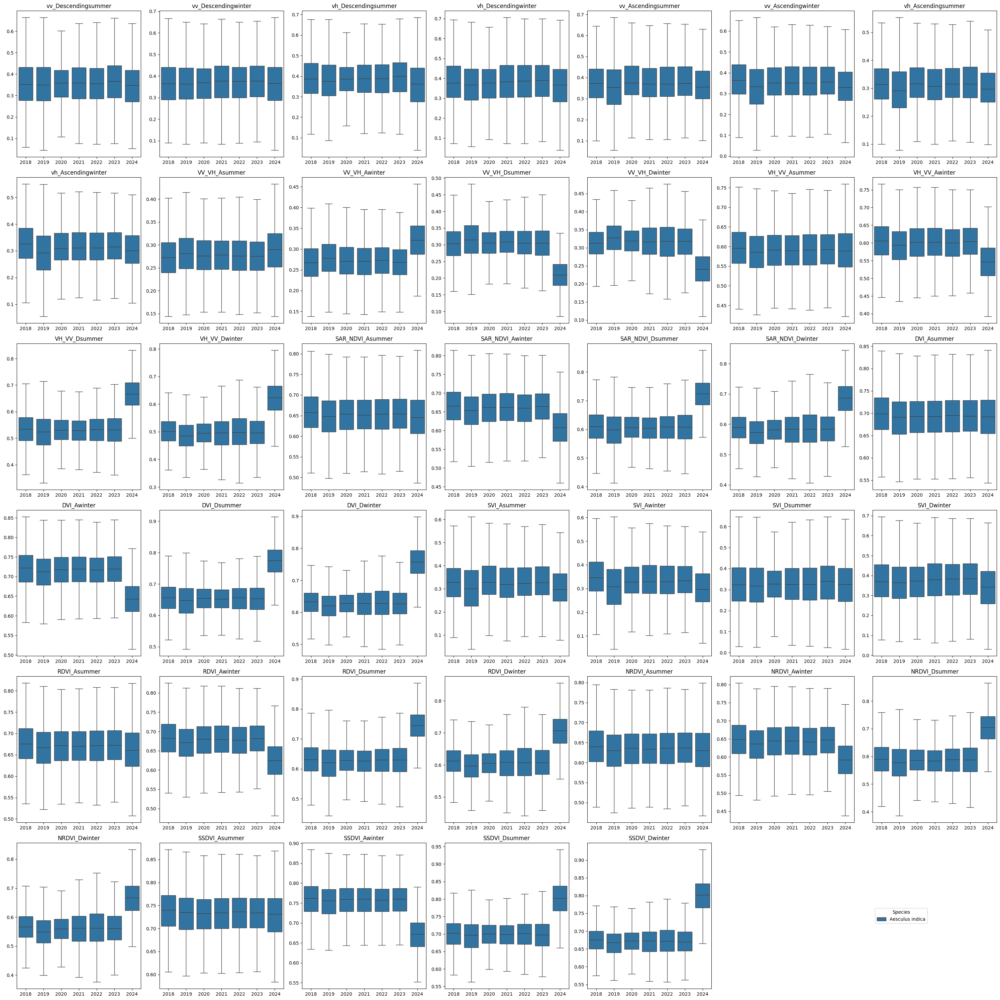

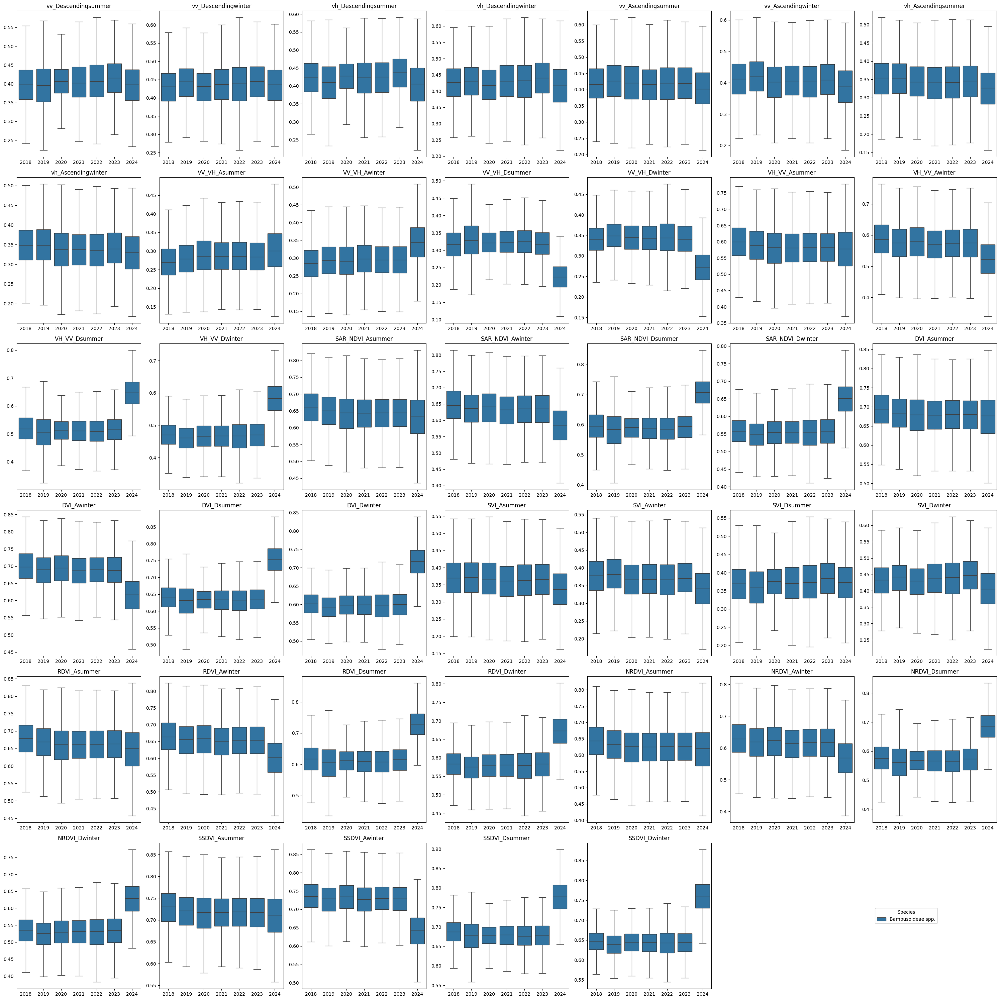

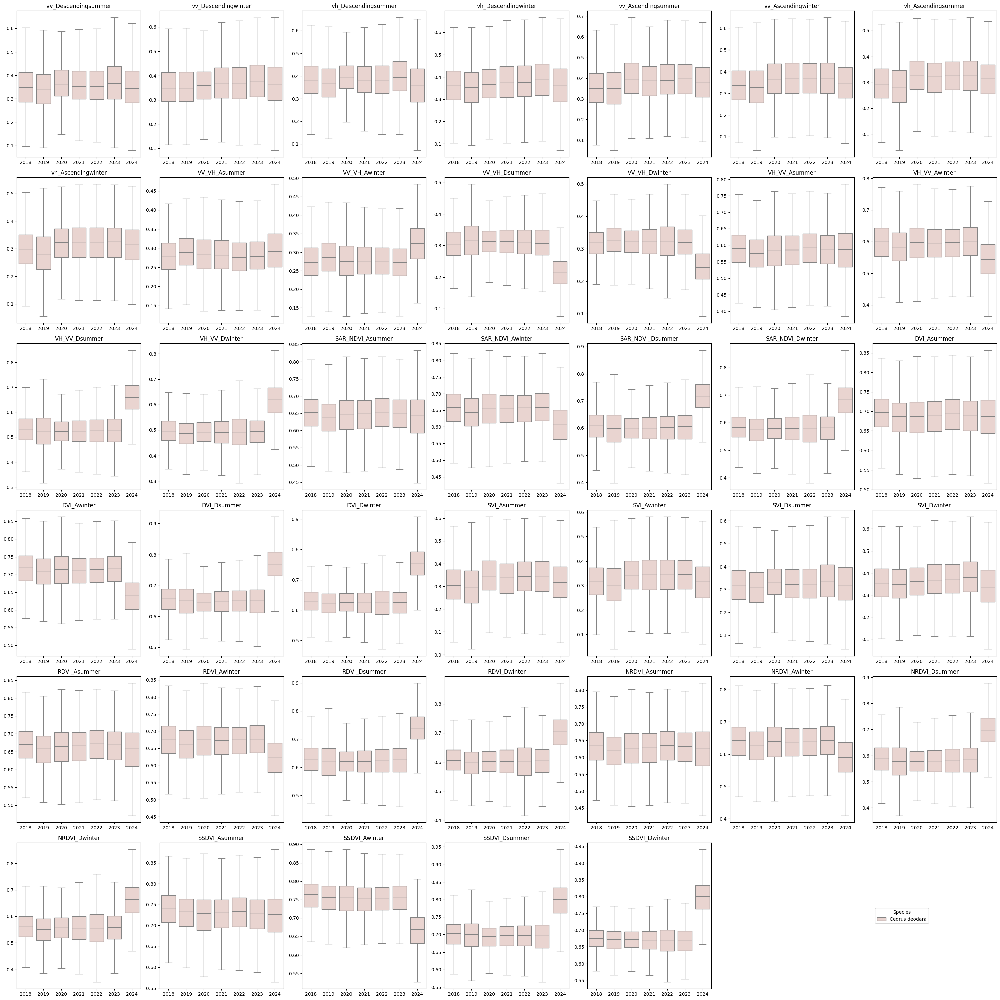

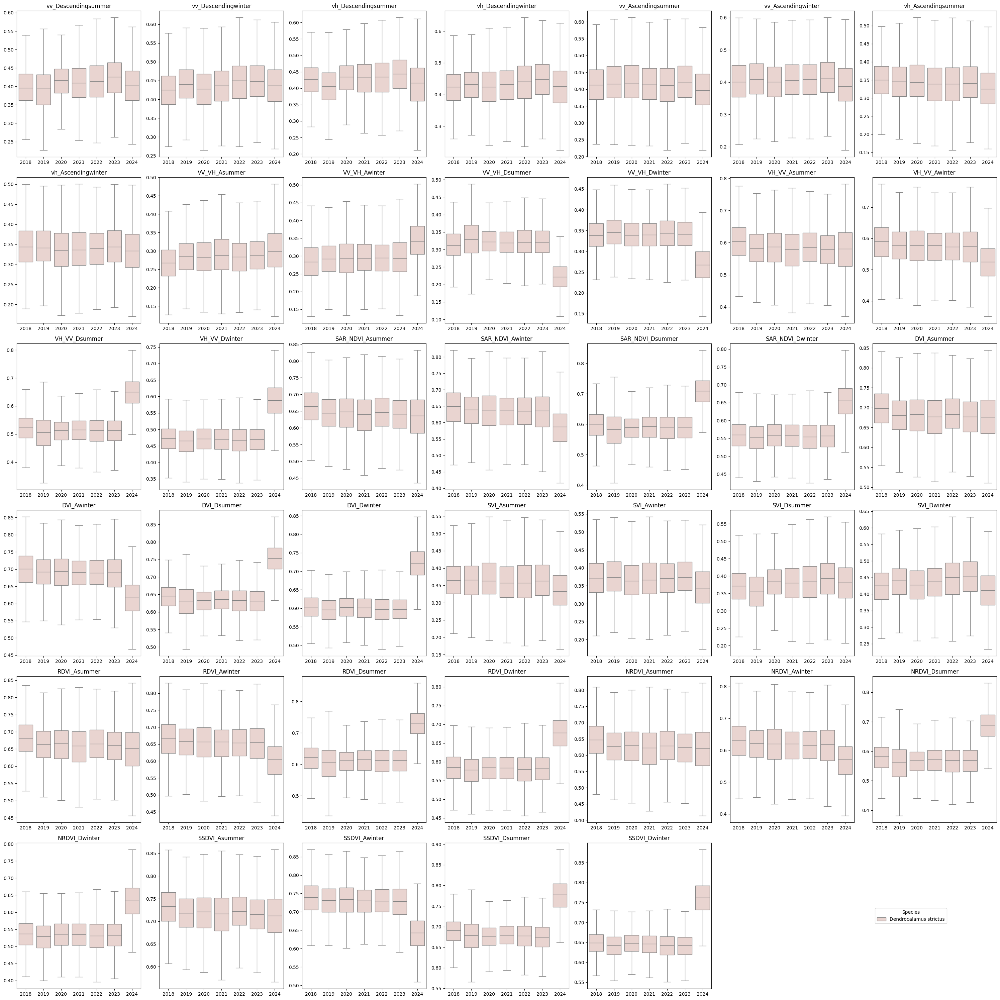

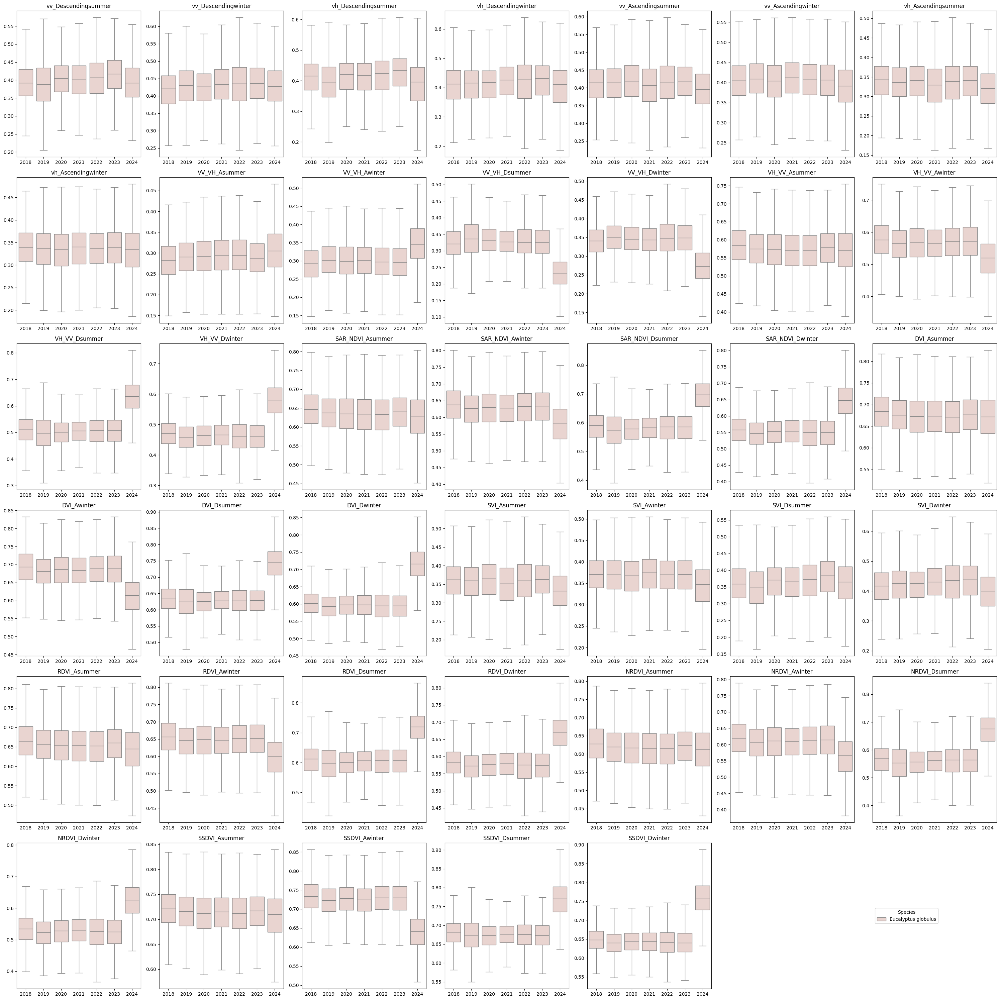

...

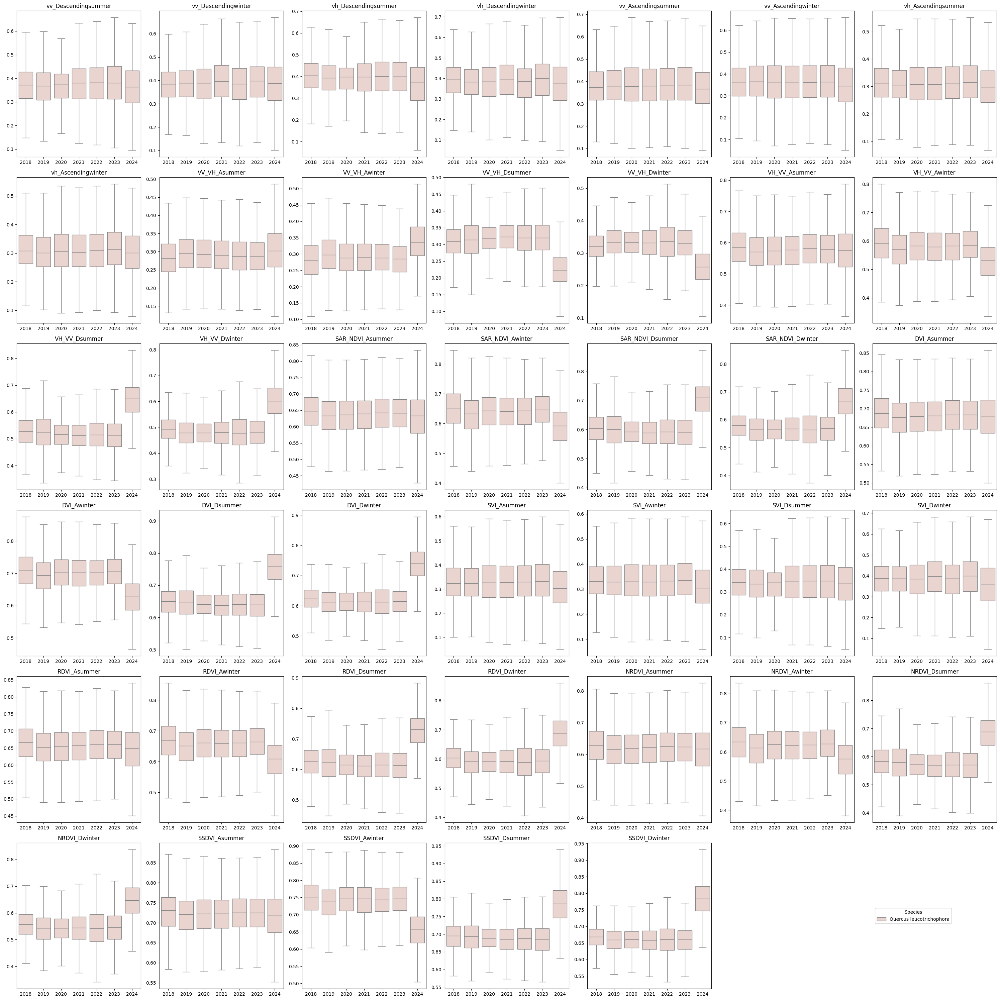

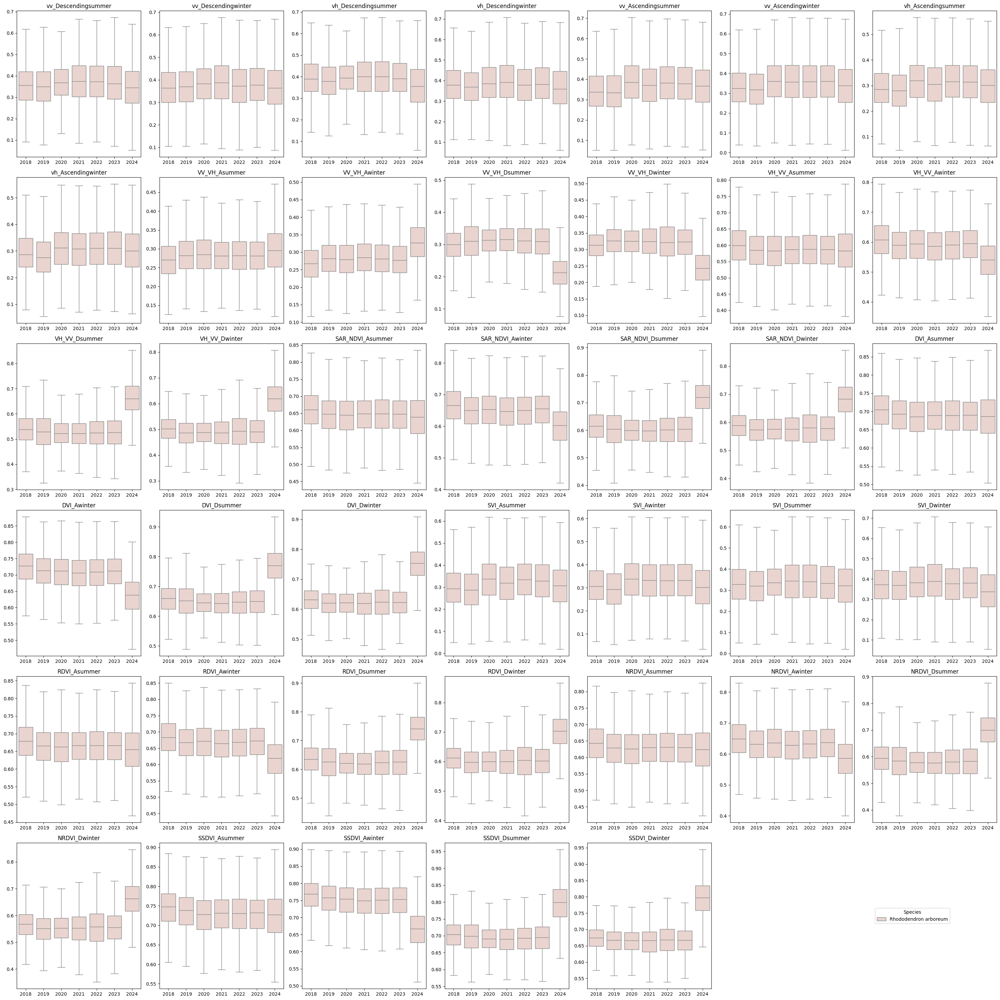

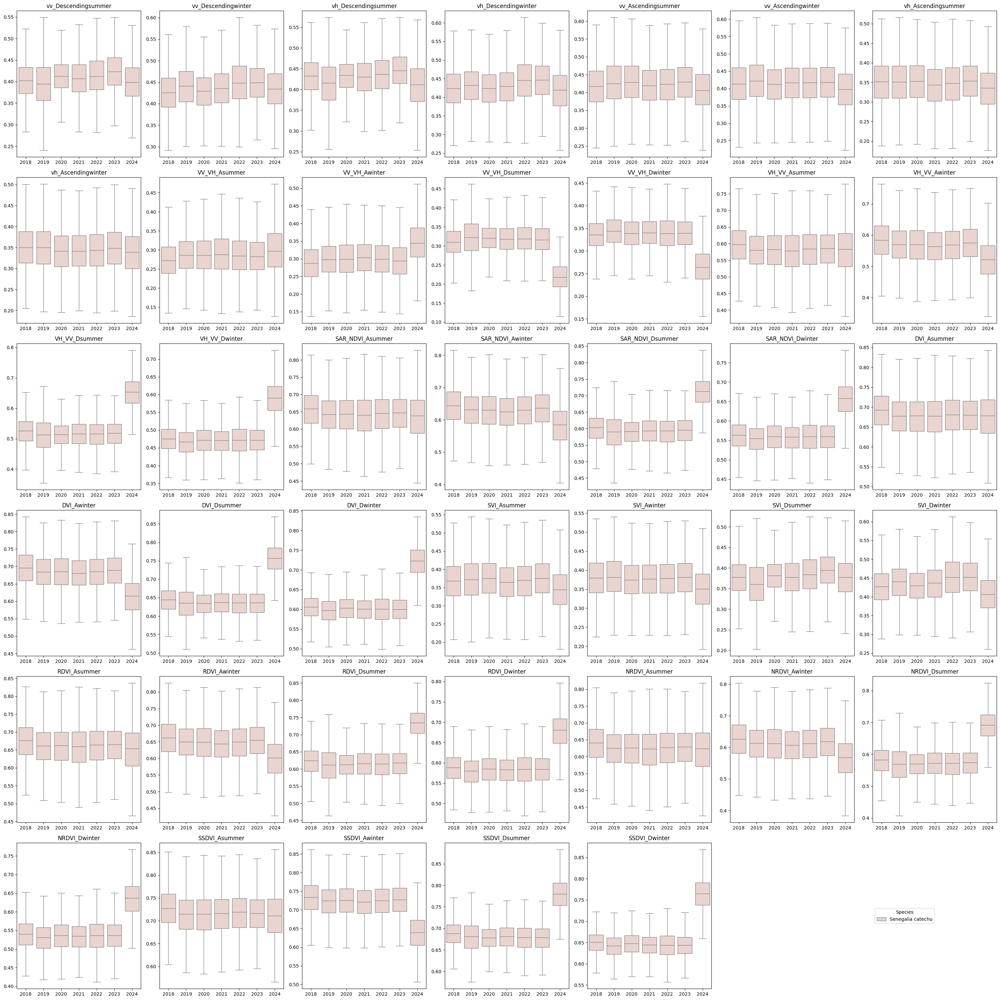

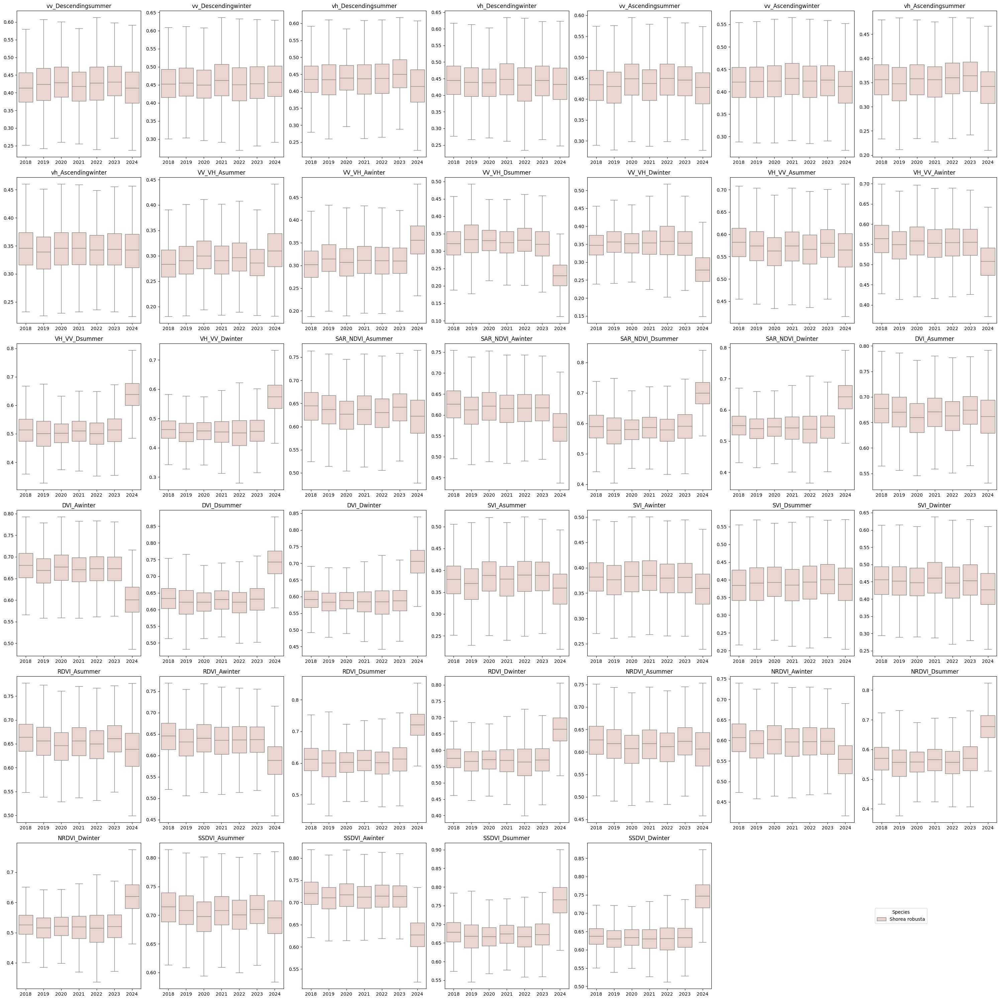

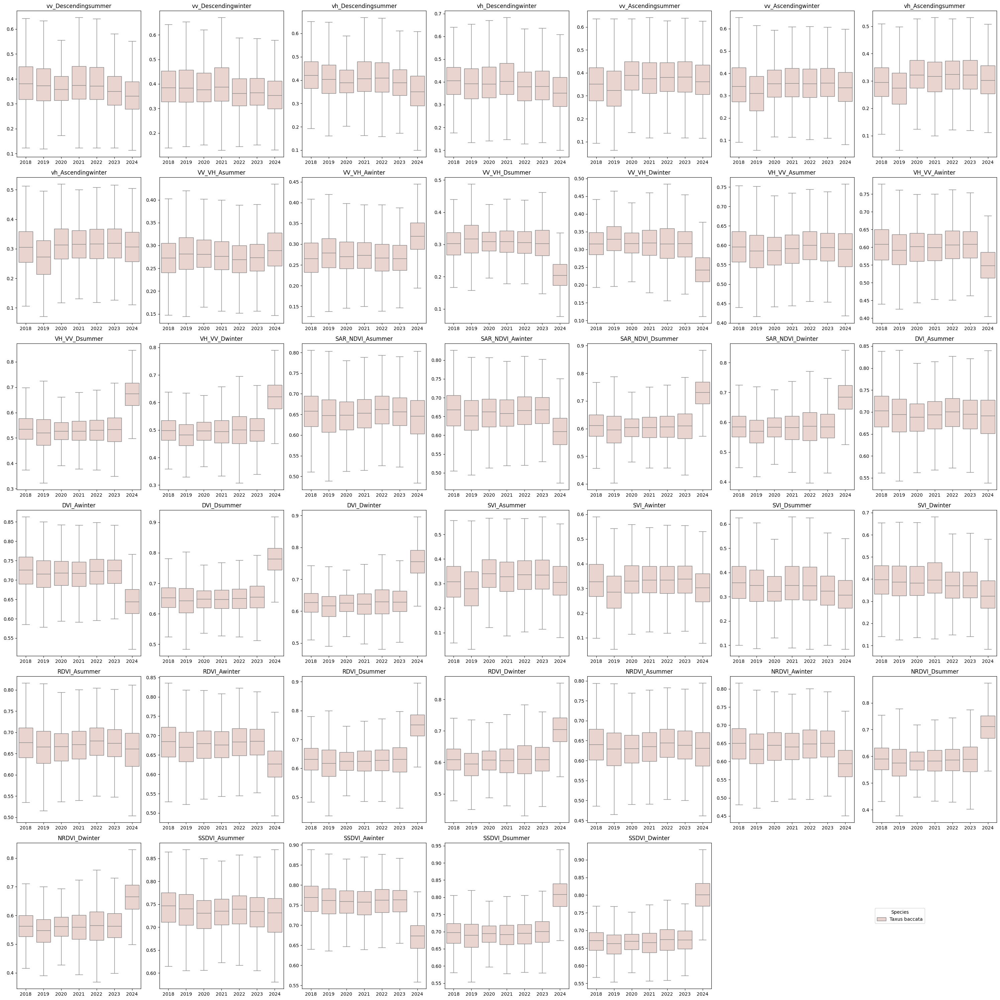

In [11]:
for specie in range(0,14,1):
    species_df = df_appended[df_appended['species']==specie]

    boxplot_out_path = out_folder.joinpath(f"intra/sentinel_1/{specie}")

    sent_boxplots(species_df, boxplot_out_path, species_df.columns[4:44], 6, 7)

##### Sentinel 2

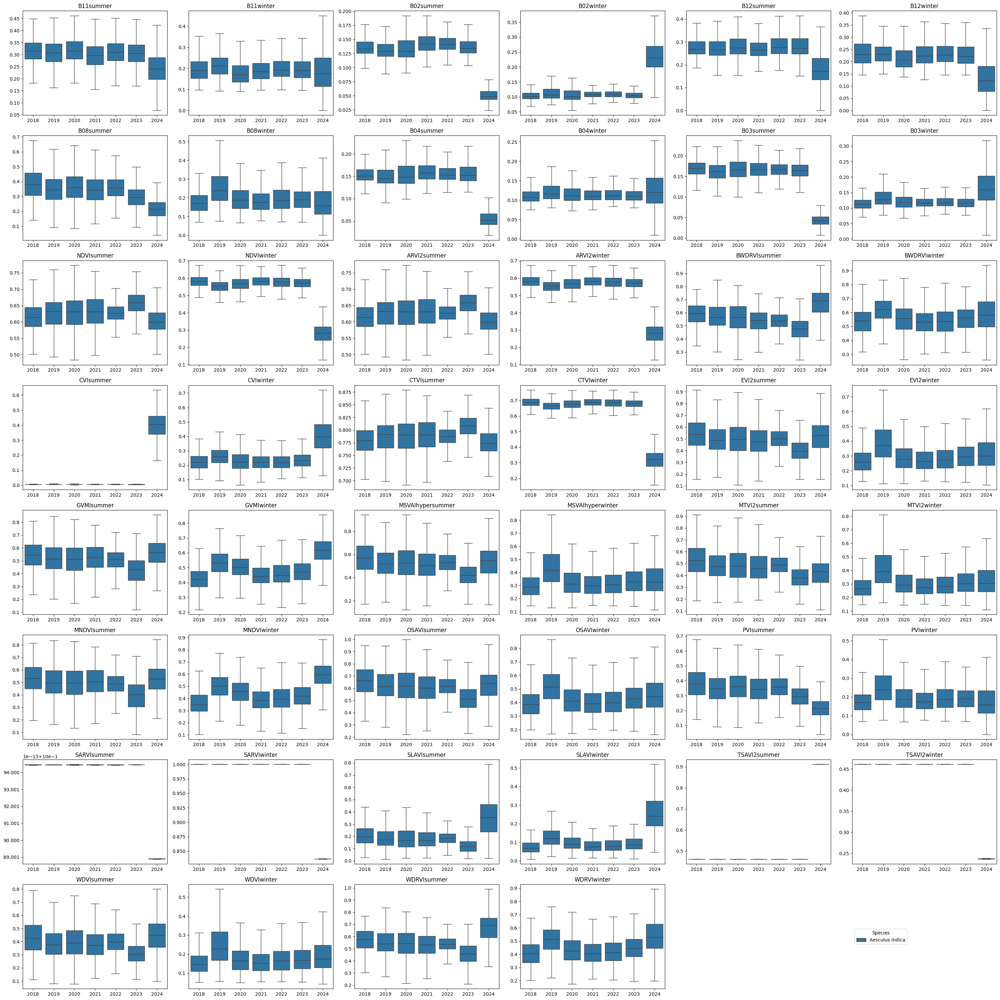

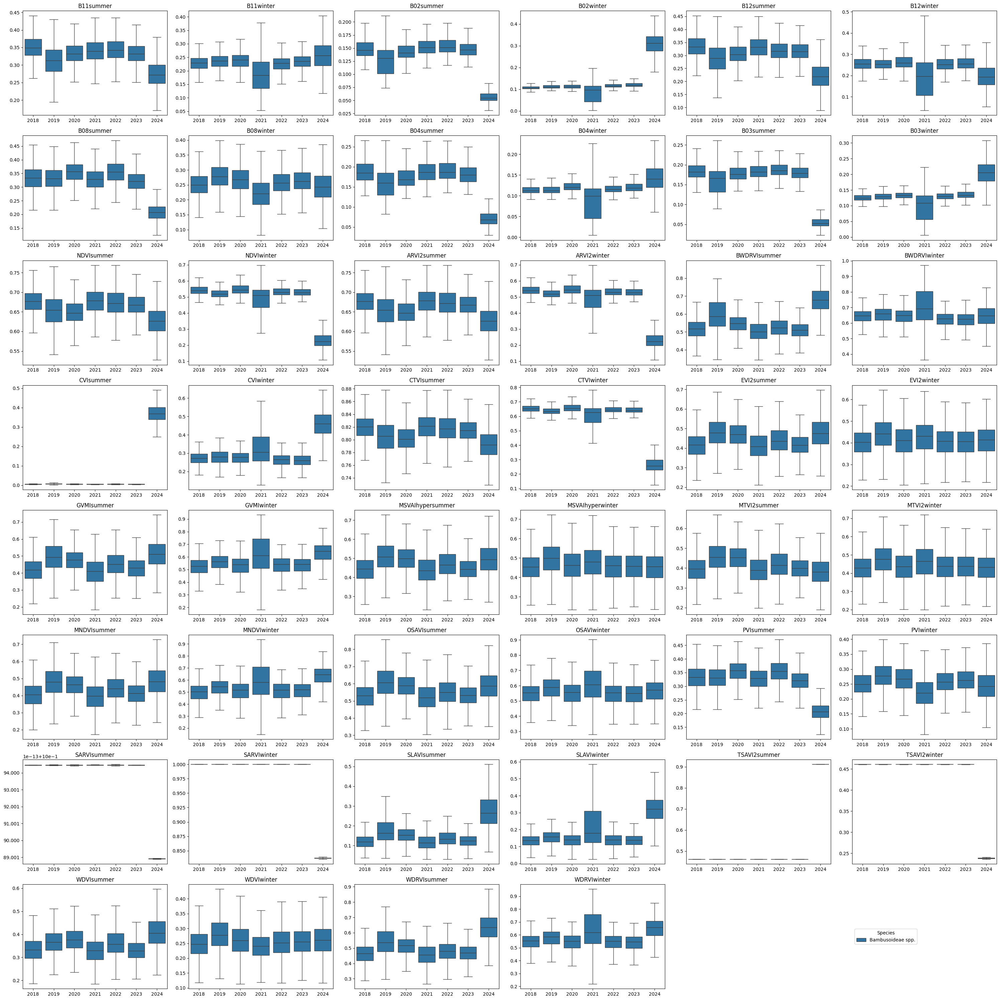

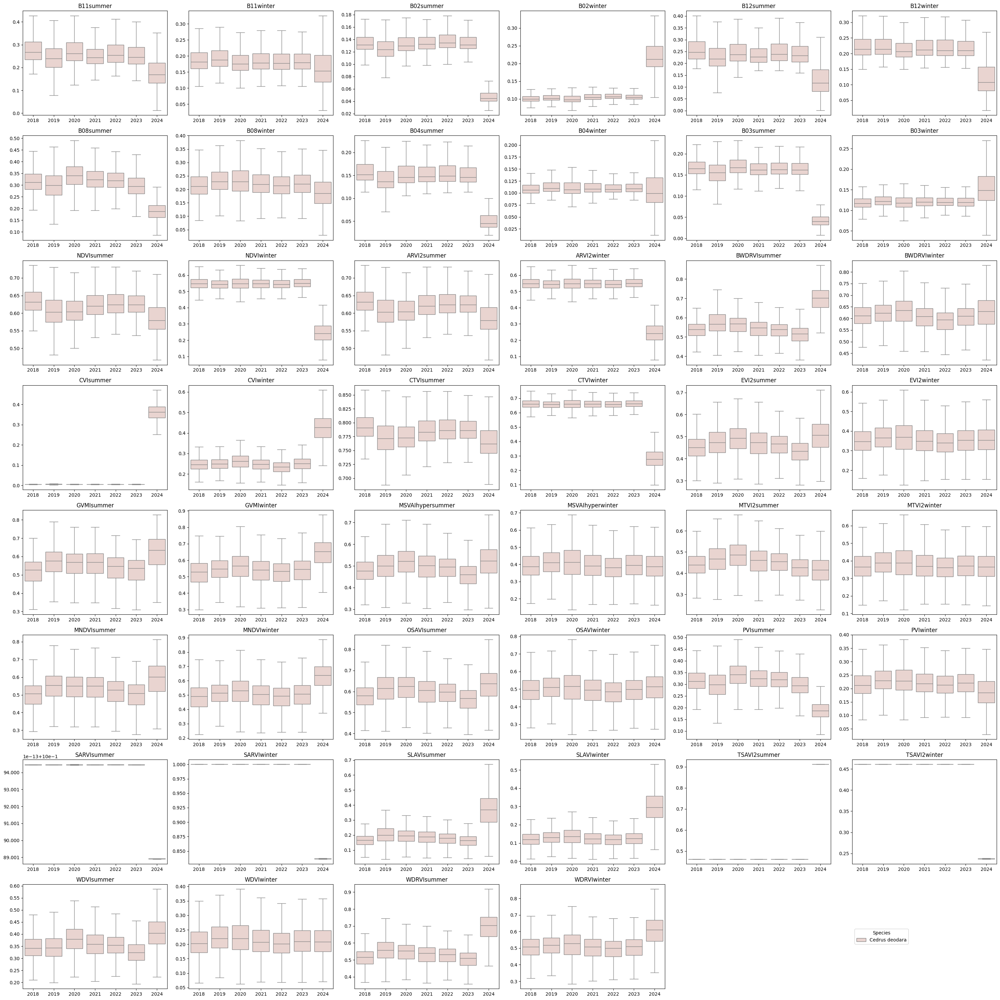

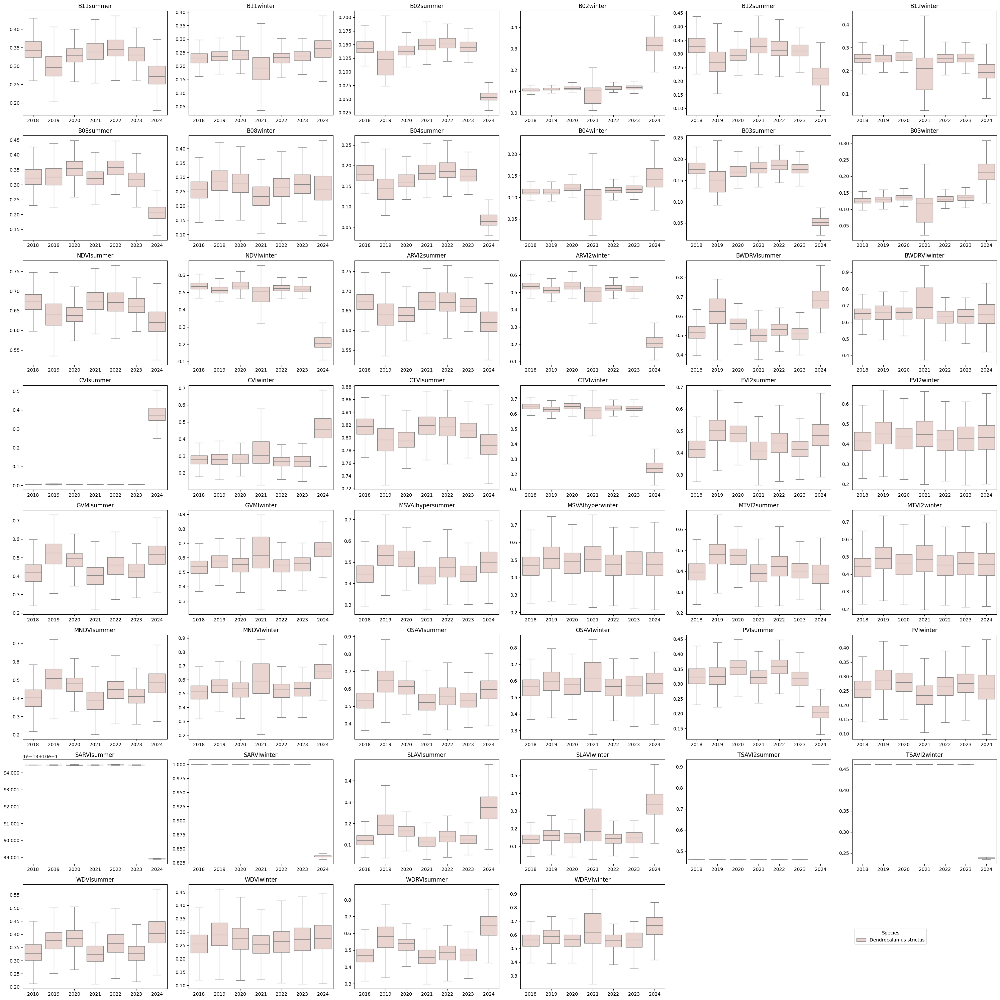

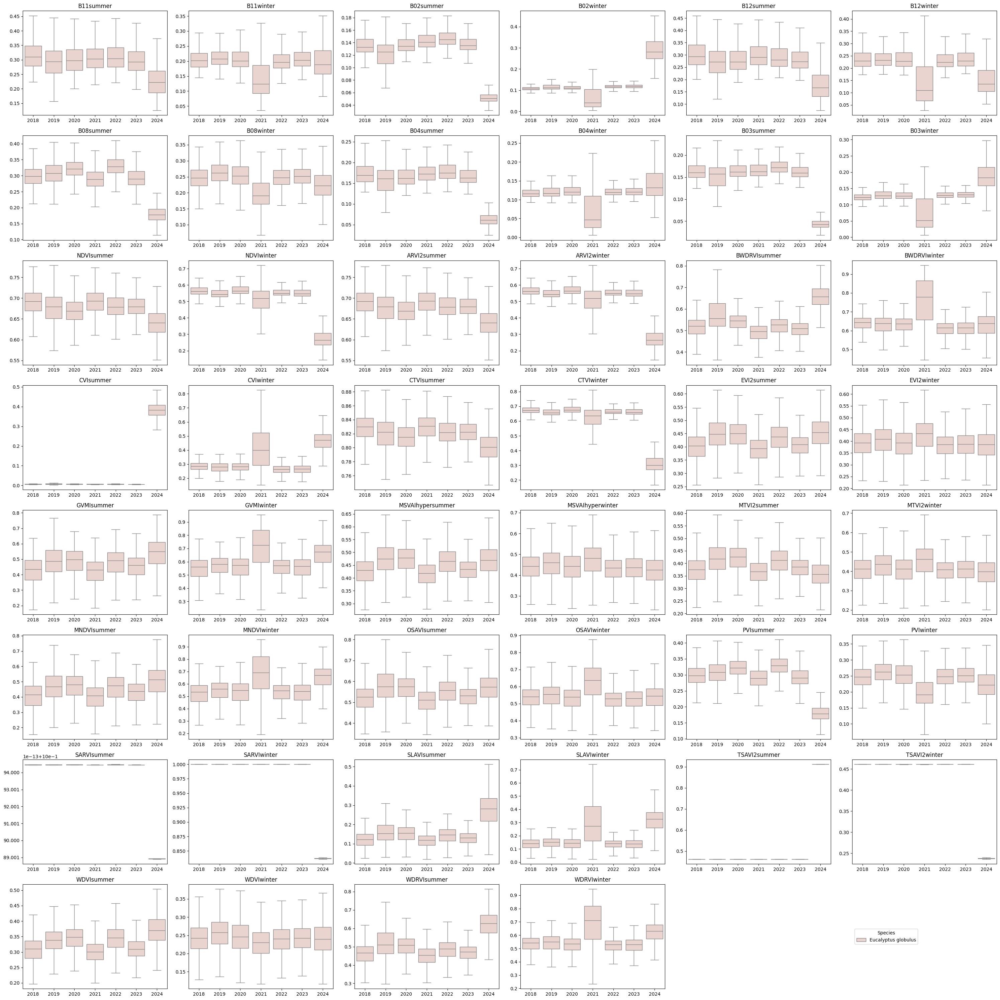

...

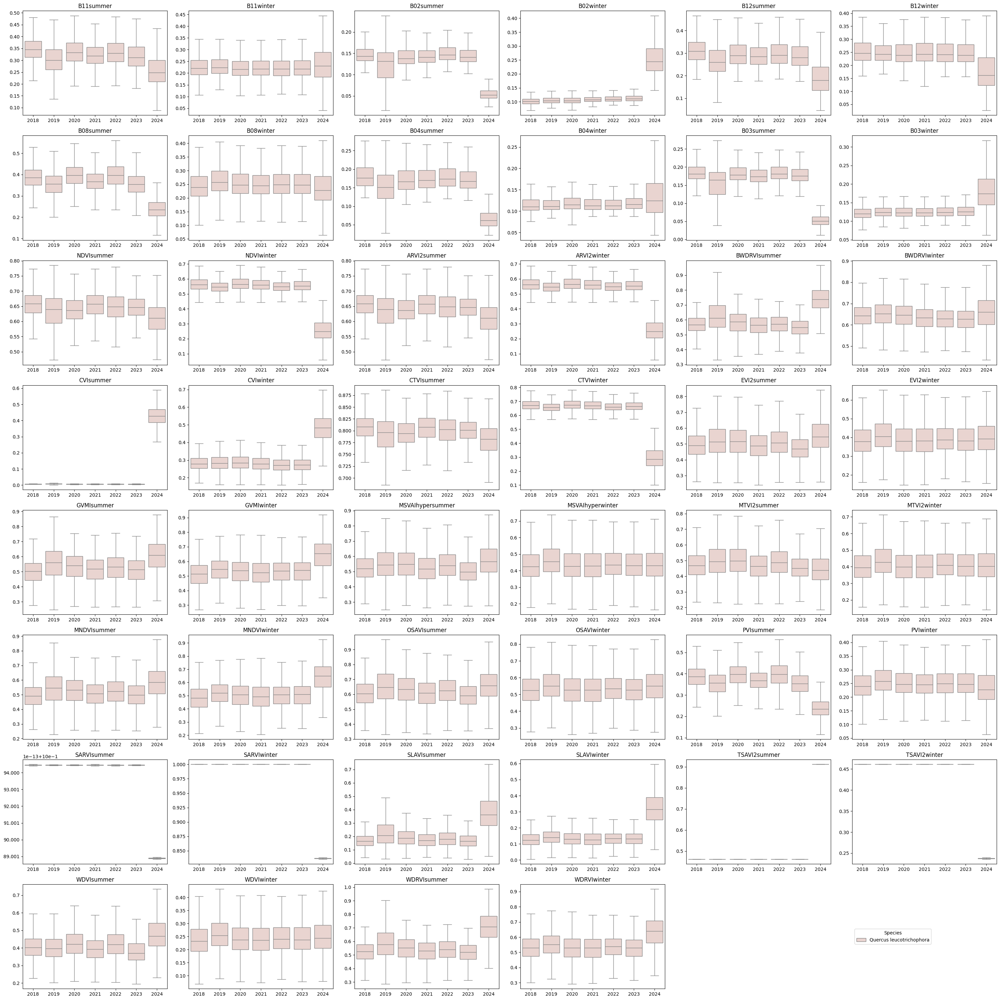

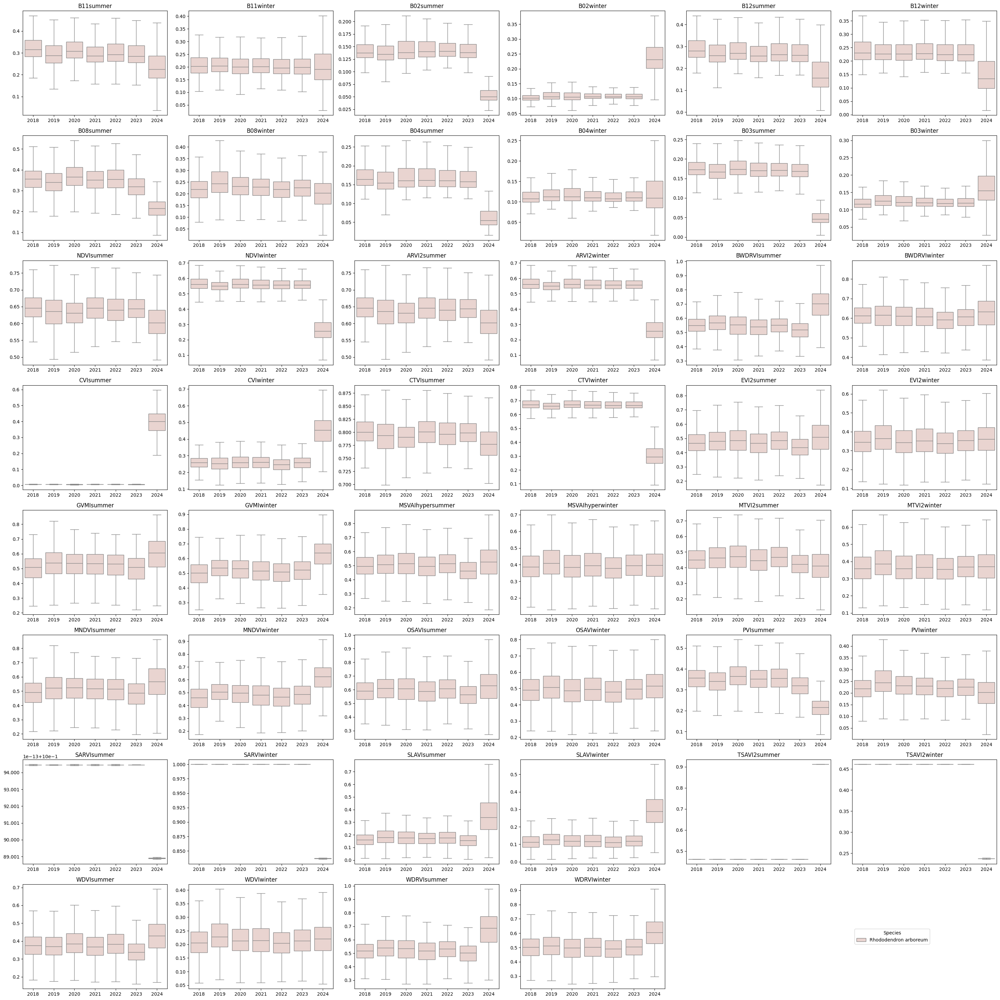

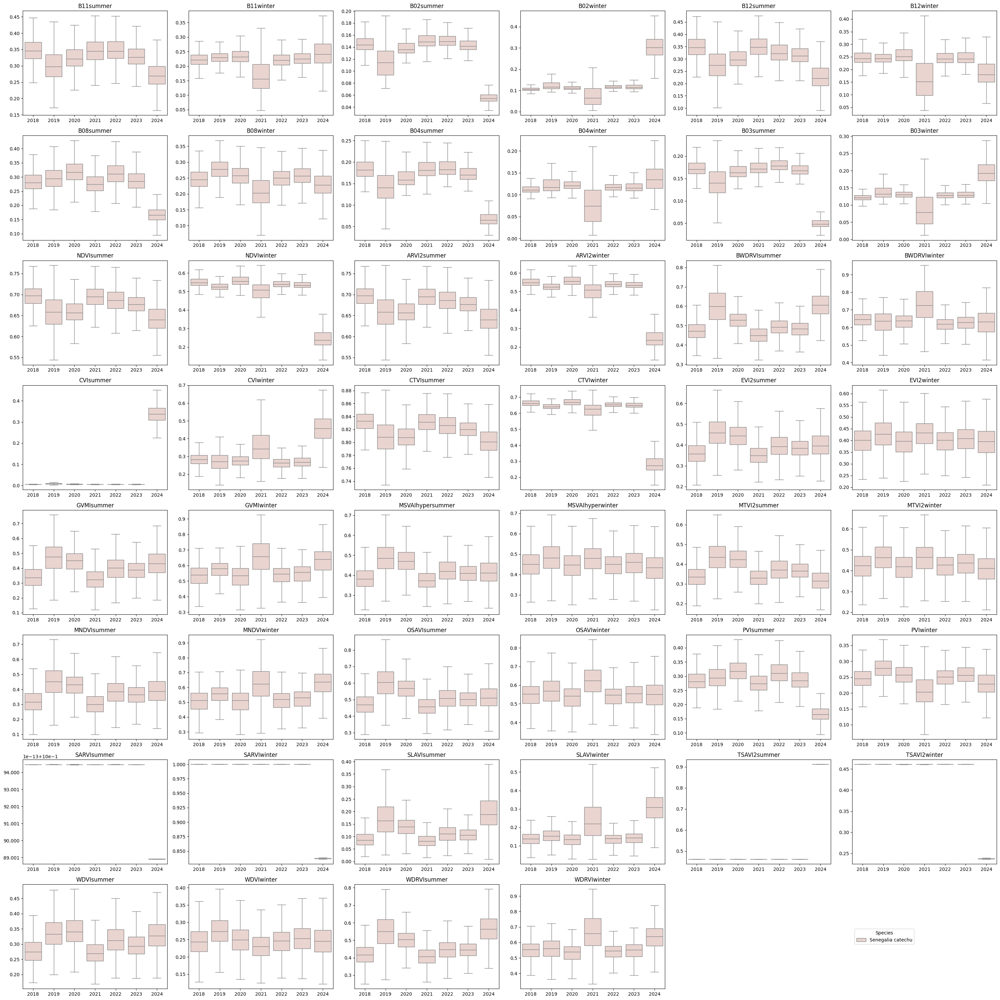

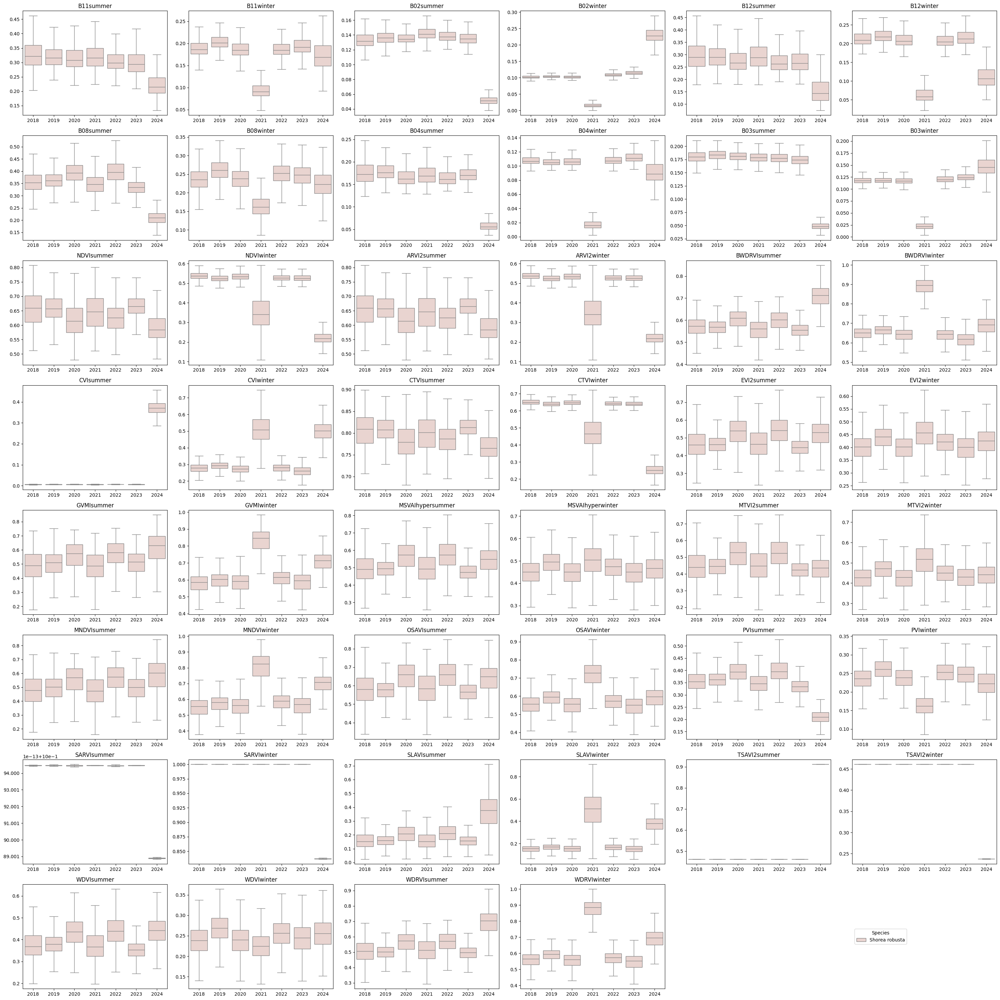

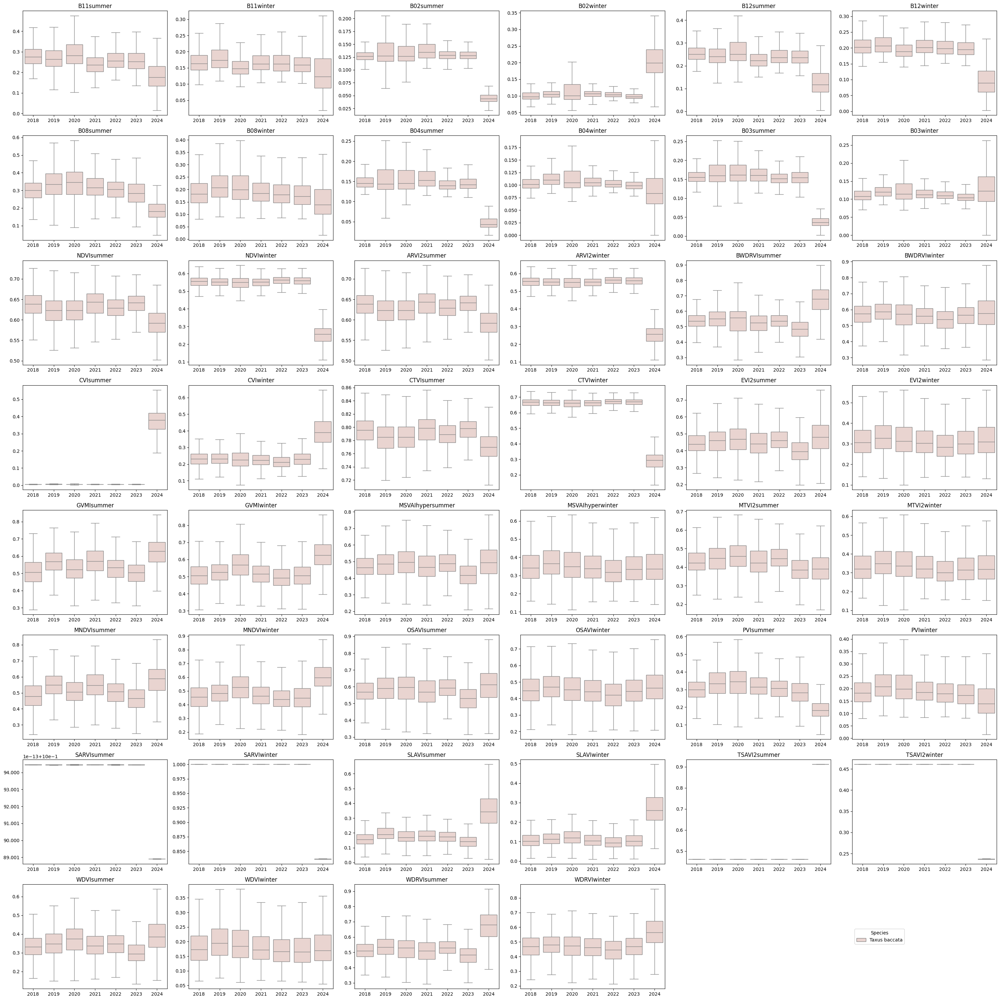

In [12]:
for specie in range(0,14,1):
    species_df = df_appended[df_appended['species']==specie]

    boxplot_out_path = out_folder.joinpath(f"intra/sentinel_2/{specie}")

    sent_boxplots(species_df, boxplot_out_path, species_df.columns[44:90], 8, 6)

## Inter Species

#### Sentinel 1

/tmp/ipykernel_47914/1021643501.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axes = plt.subplots(plt_rows, plt_cols, figsize=(30, 30))  # Create 6x7 grid


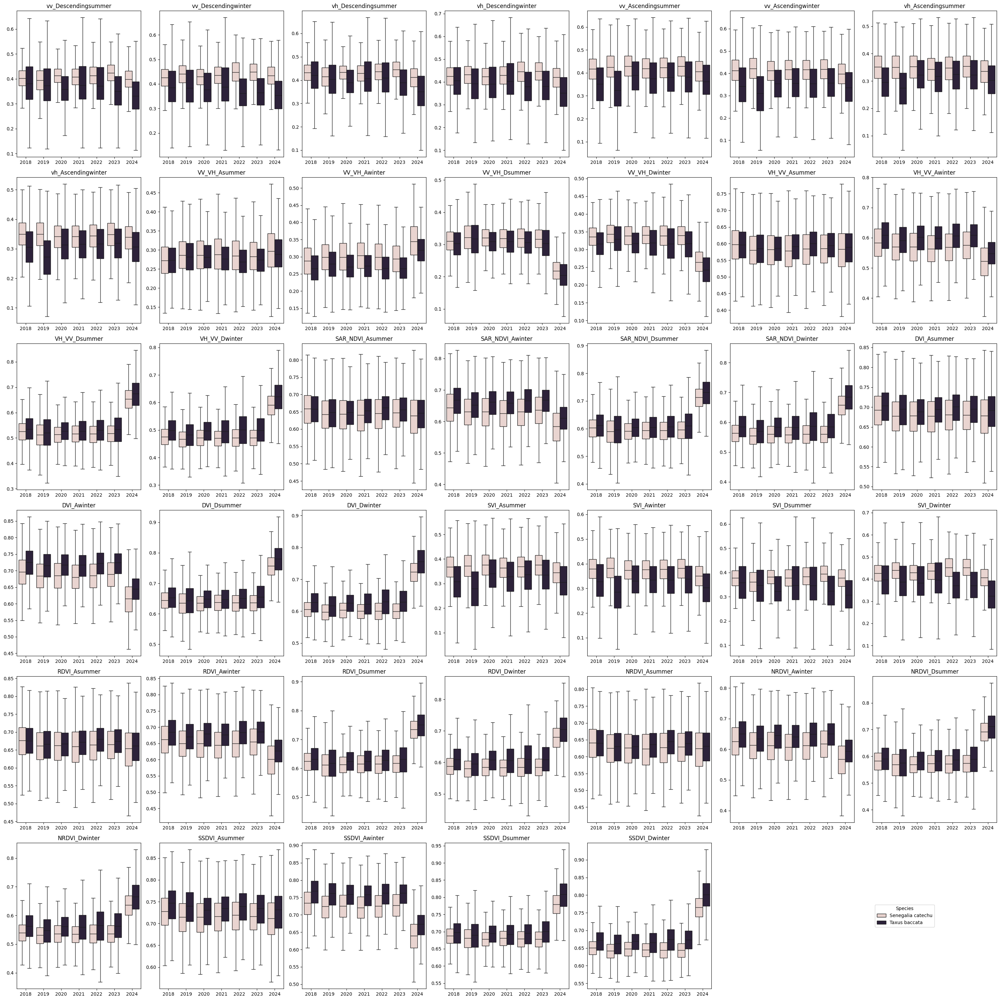

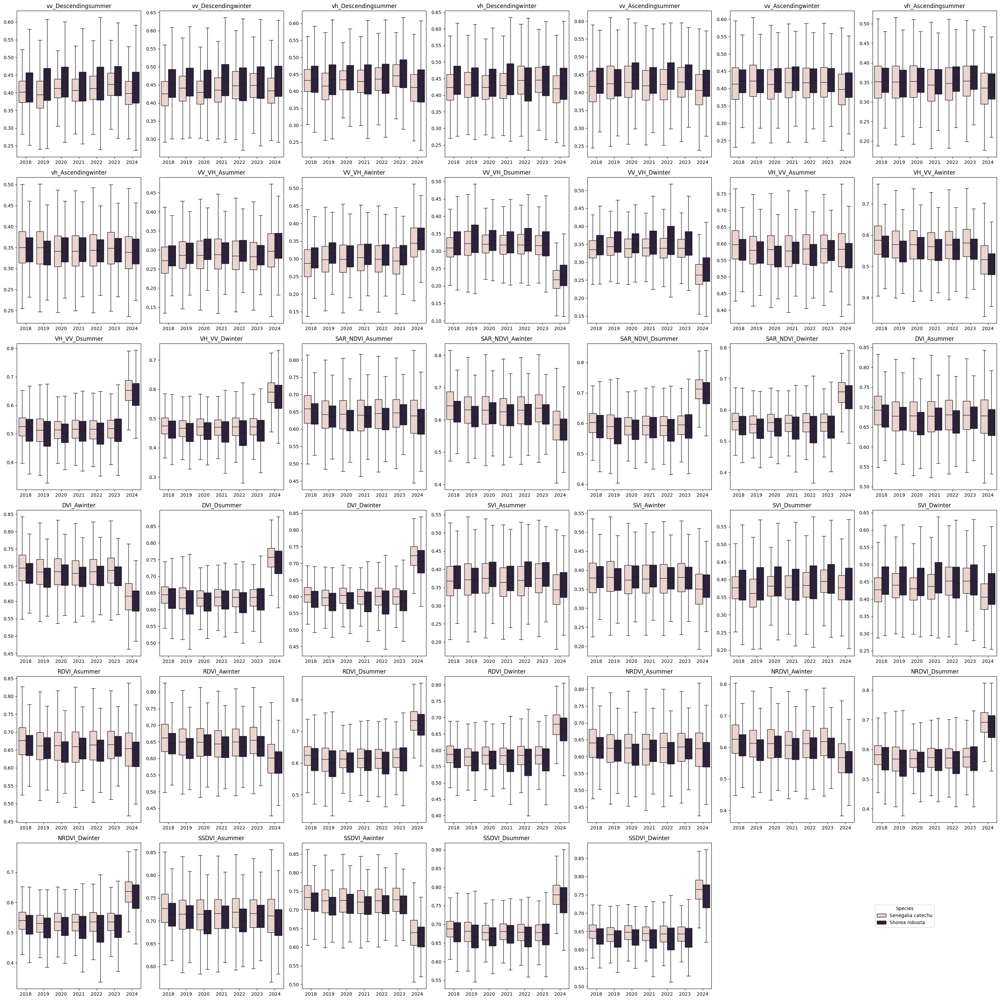

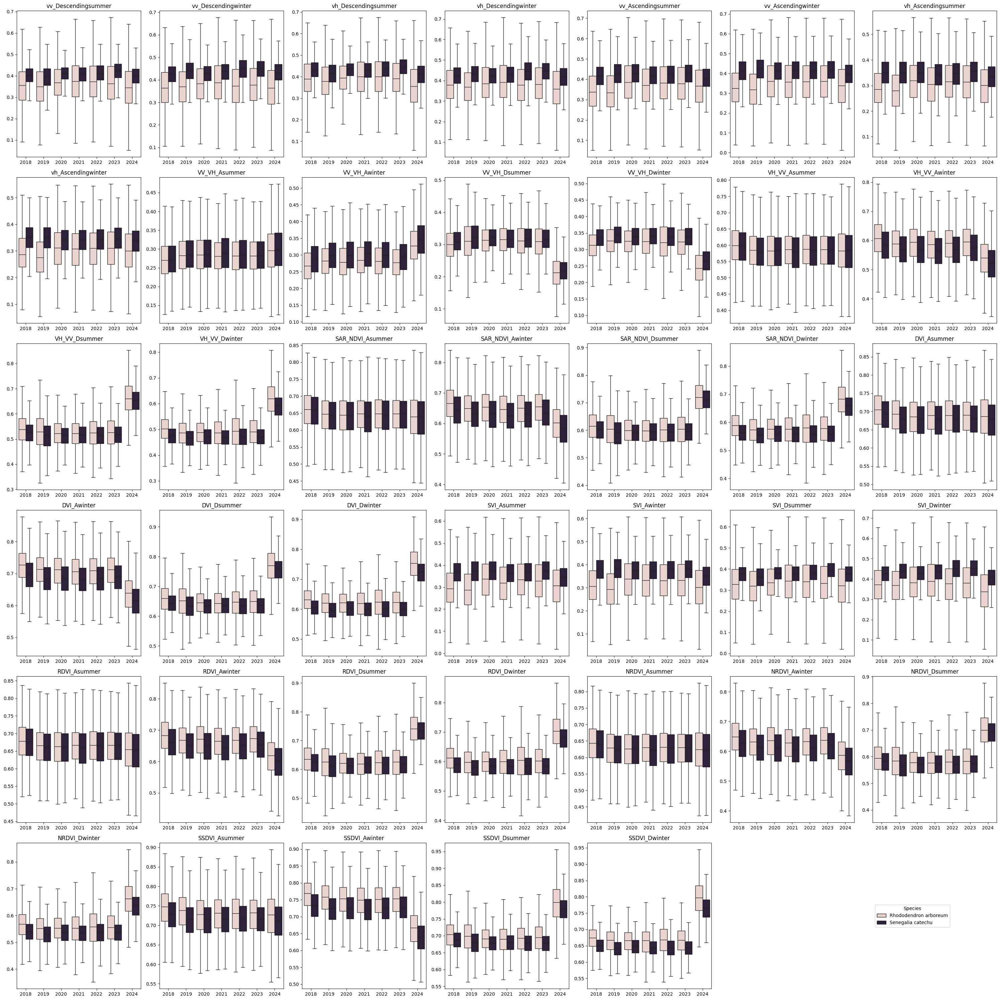

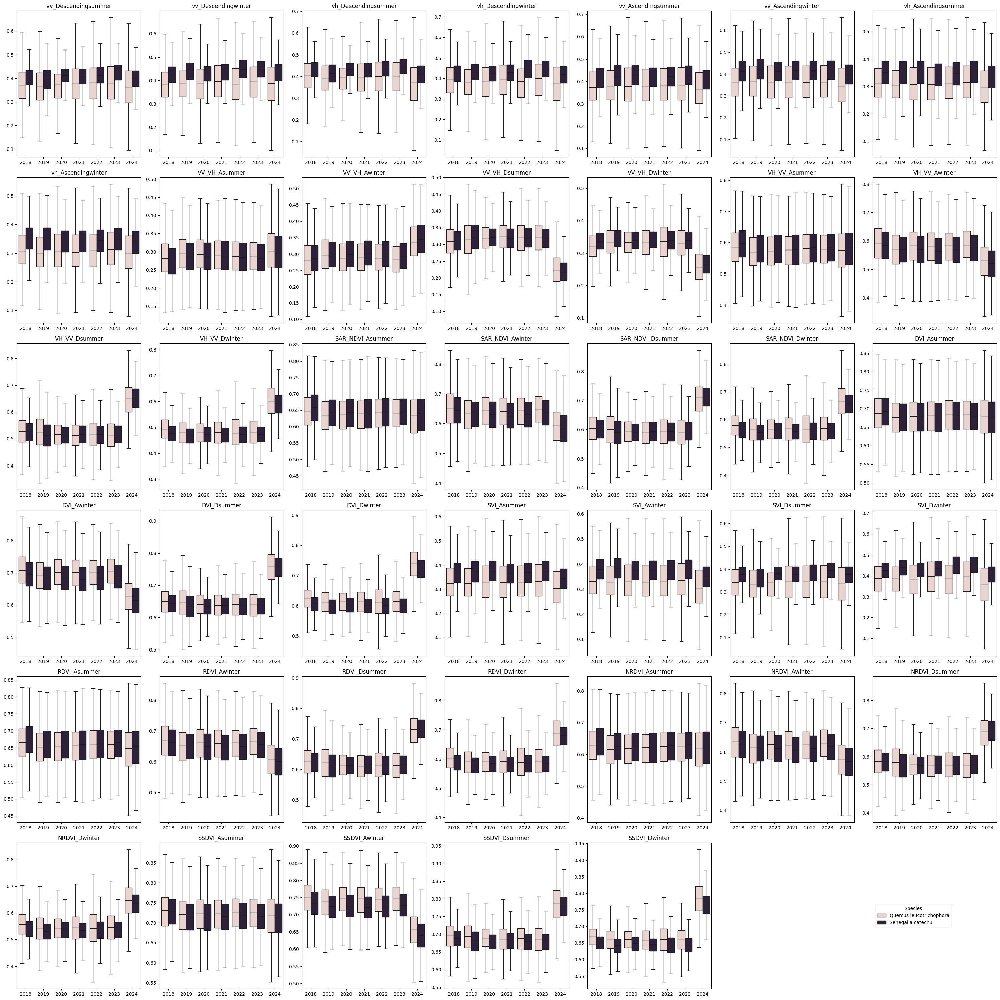

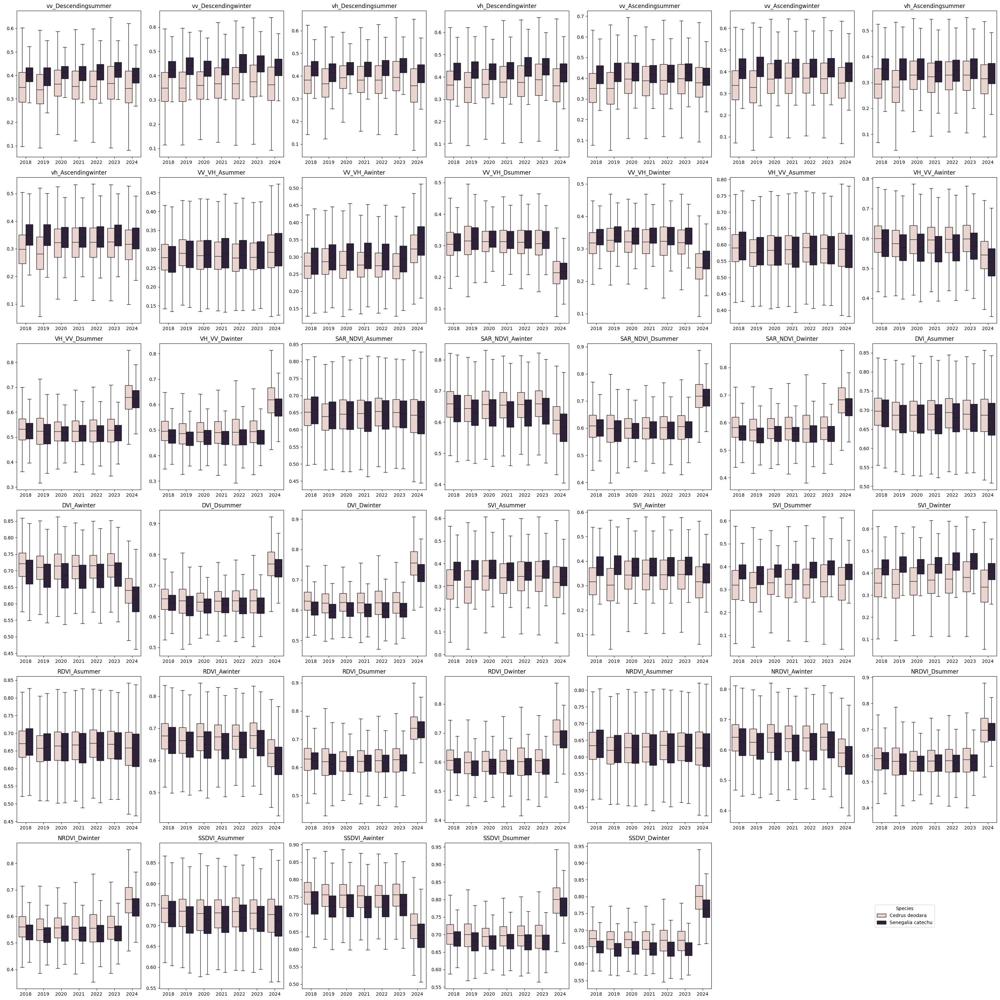

...

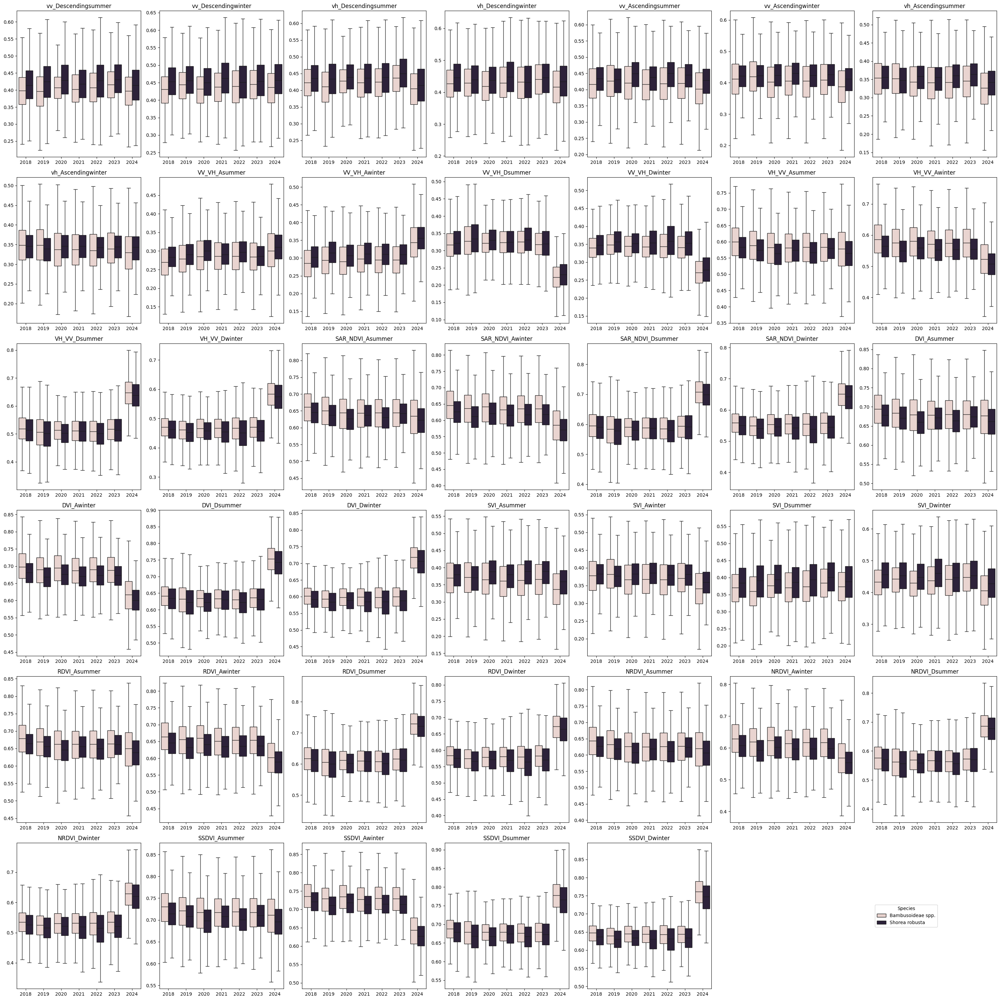

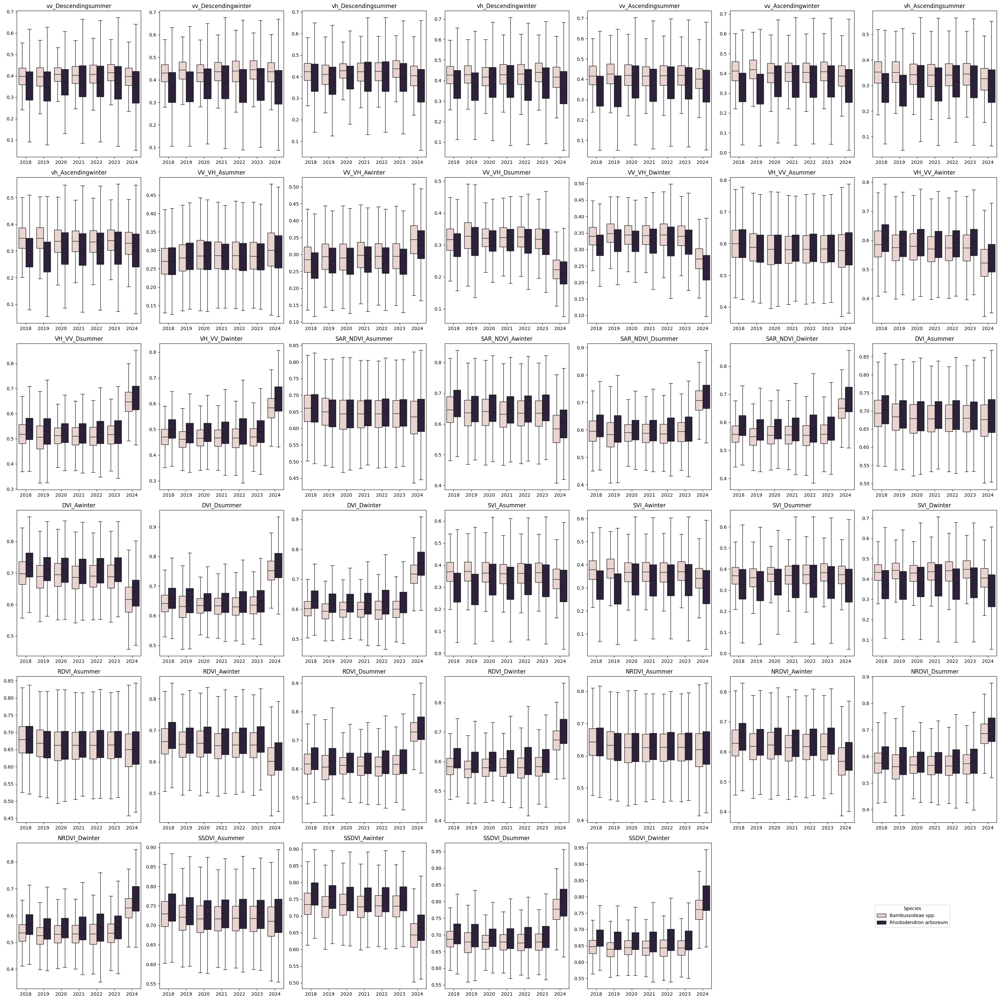

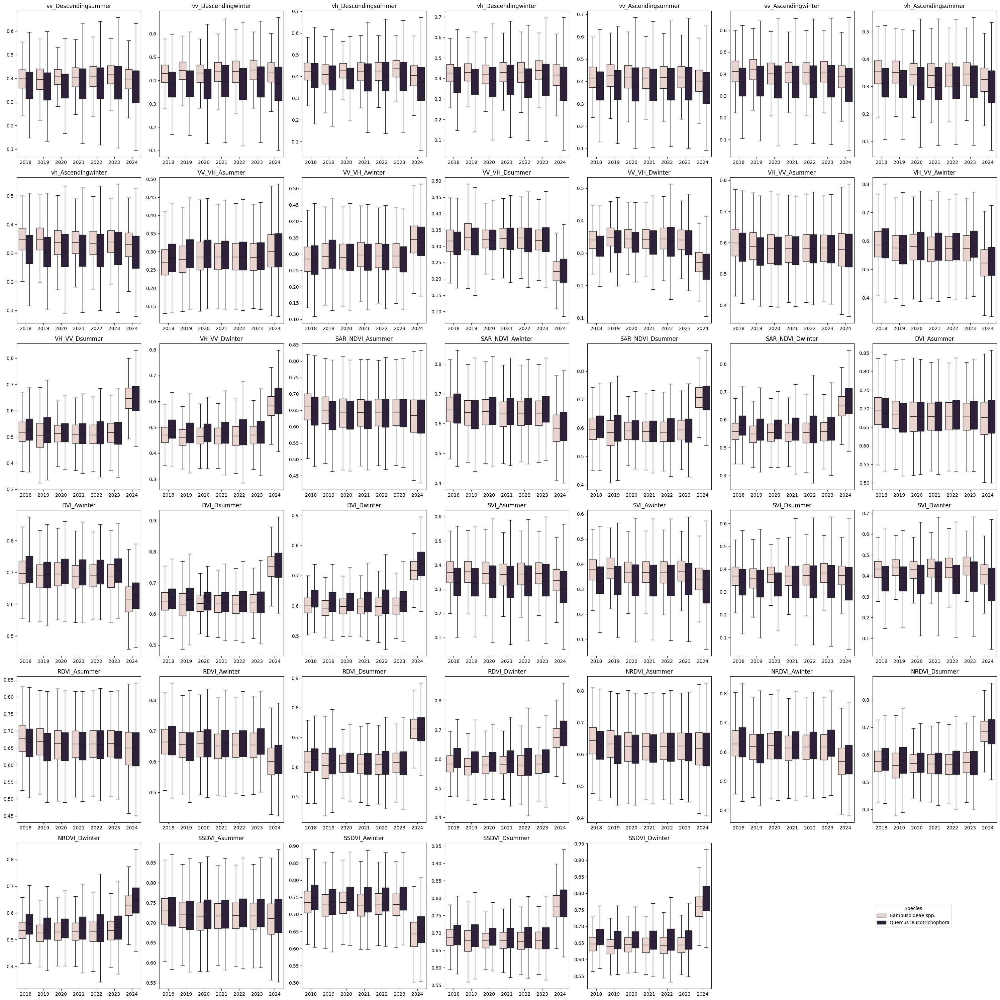

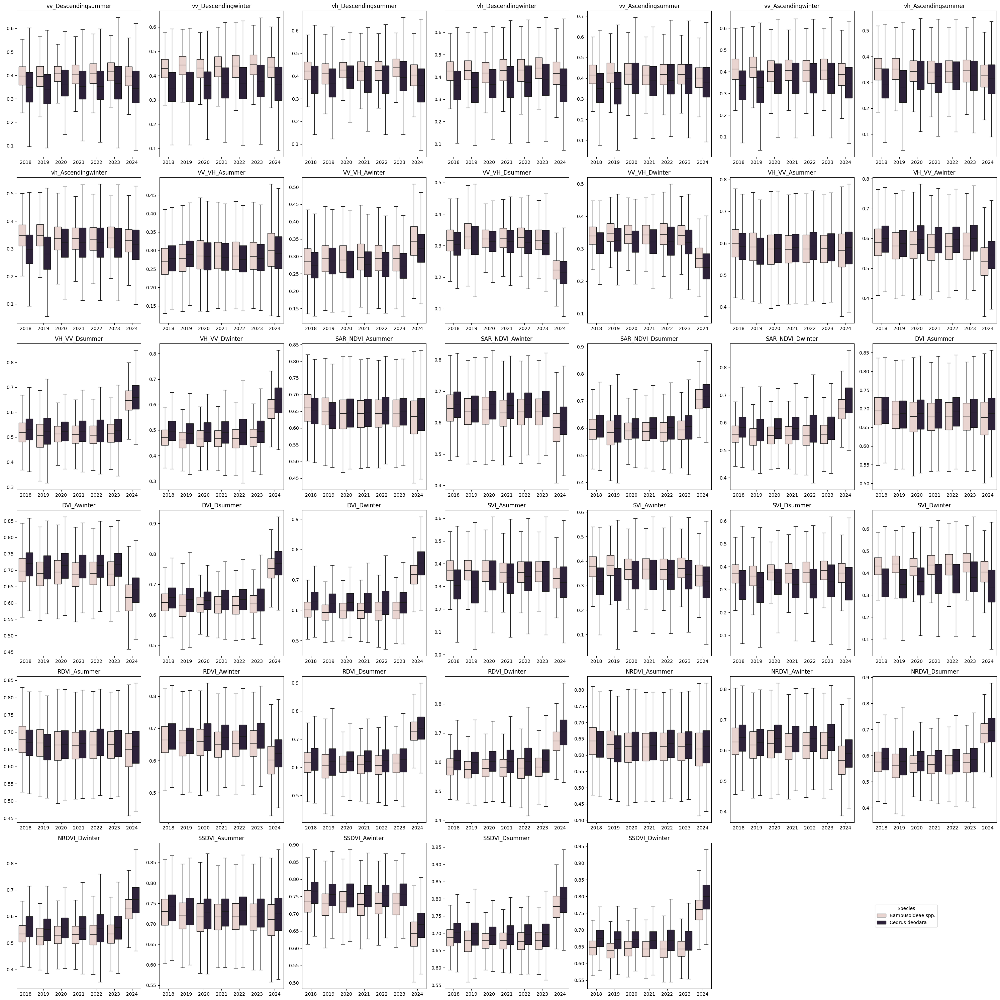

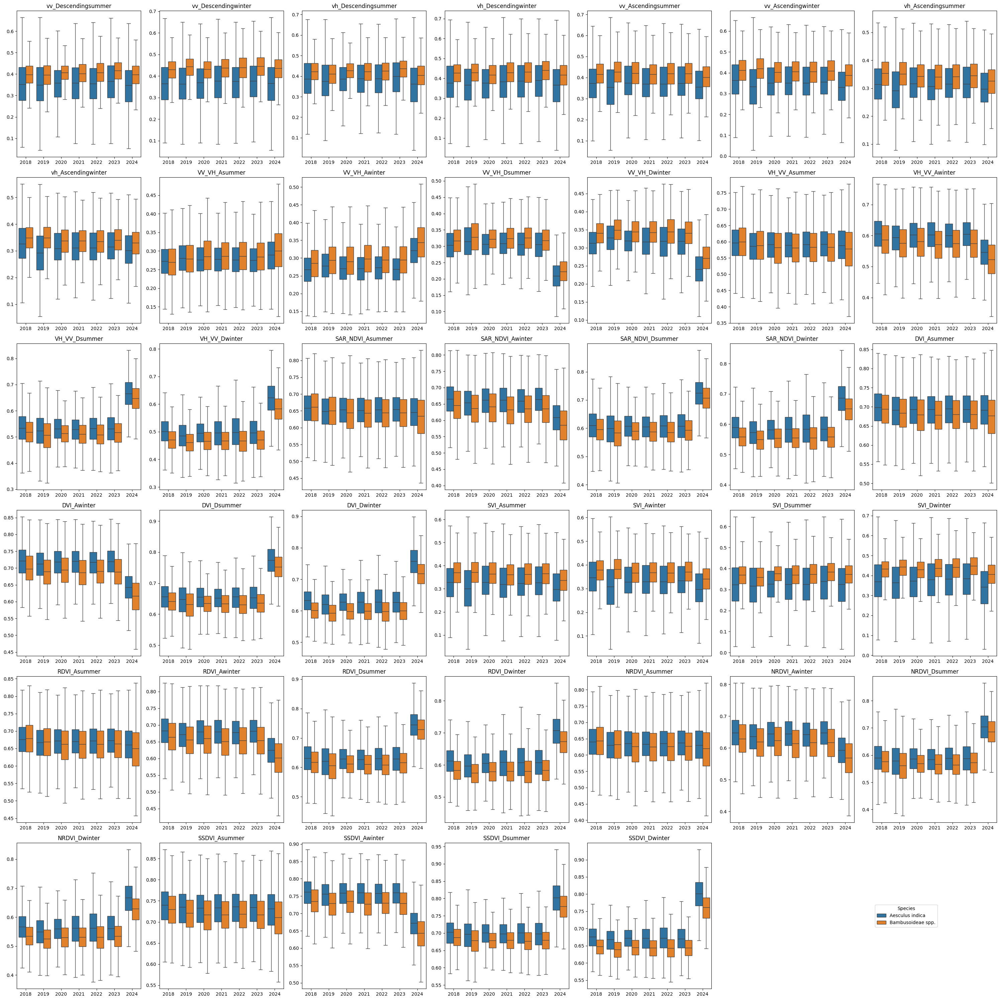

In [13]:
for target in west_low_species:
    for control in mid_line_species:

        species = [target, control]
        species_df = df_appended[df_appended['species'].isin(species)]

        boxplot_out_path = out_folder.joinpath(f"inter/sentinel_1/{target}_{control}")

        sent_boxplots(species_df, boxplot_out_path, species_df.columns[4:44], 6, 7)

#### Sentinel 2

In [ ]:
for target in west_low_species:
    for control in mid_line_species:

        species = [target, control]
        species_df = df_appended[df_appended['species'].isin(species)]

        boxplot_out_path = out_folder.joinpath(f"inter/sentinel_2/{target}_{control}")

        sent_boxplots(species_df, boxplot_out_path, species_df.columns[44:90], 8, 6)

In [15]:
round(df['SARVIwinter'].describe(), 3)

count    384882.000
mean          1.000
std           0.011
min           0.000
25%           1.000
50%           1.000
75%           1.000
max           1.000
Name: SARVIwinter, dtype: float64

In [16]:
df['SARVIwinter'].value_counts()

SARVIwinter
1.0    24949
1.0    24795
1.0    24394
1.0    24004
1.0    22876
       ...  
1.0        1
1.0        1
1.0        1
1.0        1
1.0        1
Name: count, Length: 1640, dtype: int64